## Imports and definitions

In [2]:
import json
import pprint
import pandas as pd
from IPython.display import display
! pip install av
! pip install yt-dlp
import yt_dlp
import random
import av
import av.datasets
from pathlib import Path
import pprint as pp
import requests
from opensearchpy import OpenSearch, helpers
from transformers import AutoTokenizer,AutoModel
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import numpy as np
import pickle

## Donwloading the videos

In [3]:
# Load the metadata file
with open("activity_net.v1-3.min.json", "r") as f:
    dataset = json.load(f)

with open("train.json", "r") as f:
    timestamps_db = json.load(f)

In [4]:
# Extract video information
videos = dataset.get('database', {})

# Filter videos with "subset": "training"
training_videos = {video_id: video_info for video_id, video_info in videos.items() if video_info.get('subset') == 'training'}

# Sort videos by the number of moments (annotations)
sorted_videos = sorted(training_videos.items(), key=lambda x: len(x[1].get('annotations', [])), reverse=True)

# Select the top 10 videos
top_10_videos = sorted_videos[:11]

# Print the top 10 video IDs and their moment counts
for video_id, video_info in top_10_videos:
    print(video_info)
    print(f"Video ID: {video_id}, Moments: {len(video_info.get('annotations', []))}")


{'duration': 229.86, 'subset': 'training', 'resolution': '640x480', 'url': 'https://www.youtube.com/watch?v=o1WPnnvs00I', 'annotations': [{'segment': [4.303033313169262, 13.626272158369328], 'label': 'Playing flauta'}, {'segment': [17.92930547153859, 24.025269212168485], 'label': 'Playing flauta'}, {'segment': [28.68688861154446, 35.50002465678627], 'label': 'Playing flauta'}, {'segment': [39.085885733229325, 40.52023016380655], 'label': 'Playing flauta'}, {'segment': [45.89902177847114, 48.767710639625584], 'label': 'Playing flauta'}, {'segment': [59.16670776131045, 63.469741053042114], 'label': 'Playing flauta'}, {'segment': [68.1313604524181, 95.02531852574101], 'label': 'Playing flauta'}, {'segment': [98.96976570982838, 99.686937925117], 'label': 'Playing flauta'}, {'segment': [100.7626962480499, 108.65159061622464], 'label': 'Playing flauta'}, {'segment': [111.16169336973478, 111.52027947737909], 'label': 'Playing flauta'}, {'segment': [114.38896833853353, 120.84351827613104], 'la

In [5]:
def download_video(url, output_path='downloads/'):
    ydl_opts = {
        'outtmpl': f'{output_path}/%(id)s - %(title)s.%(ext)s',
        'format': 'mp4/bestvideo+bestaudio',
        'merge_output_format': 'mp4'
    }
    with yt_dlp.YoutubeDL(ydl_opts) as ydl:
        ydl.download([url])

In [6]:
count = 0
for video_id, video_info in top_10_videos:
    video_url = video_info.get('url')
    if video_url and "youtube.com" in video_url and count < 11:
        try:
            download_video(video_url)
            print(f"Downloaded: {video_id}")
            count += 1
        except Exception as e:
            print(f"Failed to download {video_id}: {e}")
    else:
        print(f"Invalid or unsupported URL for video ID or already got 10 videos: {video_id}")

[youtube] Extracting URL: https://www.youtube.com/watch?v=o1WPnnvs00I
[youtube] o1WPnnvs00I: Downloading webpage
[youtube] o1WPnnvs00I: Downloading tv client config
[youtube] o1WPnnvs00I: Downloading player 59b252b9-main
[youtube] o1WPnnvs00I: Downloading tv player API JSON
[youtube] o1WPnnvs00I: Downloading ios player API JSON


         n = sWfRLOcN5s6IPY60Y1c6 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = t2uX_arHQA4ObBacTl3D ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = kks9GgU5FsEKGLNEQigJ ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] o1WPnnvs00I: Downloading m3u8 information
[info] o1WPnnvs00I: Downloading 1 format(s): 231
[download] downloads\o1WPnnvs00I - Irish March (Fife & Flute) – Wouter Kellerman (Live).mp4 has already been downloaded
[download] 100% of   10.19MiB
Downloaded: o1WPnnvs00I
[youtube] Extracting URL: https://www.youtube.com/watch?v=oGwn4NUeoy8
[youtube] oGwn4NUeoy8: Downloading webpage
[youtube] oGwn4NUeoy8: Downloading tv client config
[youtube] oGwn4NUeoy8: Downloading player 59b252b9-main
[youtube] oGwn4NUeoy8: Downloading tv player API JSON
[youtube] oGwn4NUeoy8: Downloading ios player API JSON


         n = xNkdmqvwOh5bO_KAt85e ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = PrfpwGWWKMC5GR0UFQtO ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = tqCSmc3sP_vA3cWouhnF ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] oGwn4NUeoy8: Downloading m3u8 information
[info] oGwn4NUeoy8: Downloading 1 format(s): 231
[download] downloads\oGwn4NUeoy8 - Jessica Ryckewaert plays Congas Drums Mezza Voce, Rhythm Concert.mp4 has already been downloaded
[download] 100% of    5.66MiB
Downloaded: oGwn4NUeoy8
[youtube] Extracting URL: https://www.youtube.com/watch?v=VEDRmPt_-Ms
[youtube] VEDRmPt_-Ms: Downloading webpage
[youtube] VEDRmPt_-Ms: Downloading tv client config
[youtube] VEDRmPt_-Ms: Downloading player 59b252b9-main
[youtube] VEDRmPt_-Ms: Downloading tv player API JSON
[youtube] VEDRmPt_-Ms: Downloading ios player API JSON


         n = JwEPXrwnFhn1jVJ8SPyL ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = 9GN2WxZDWLpasQuwhMaa ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = x9V1IHUOfrLhpsDAbfZQ ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = Kr0qllAOhw2cCpMcy8Lf ; player = https://www.youtube.com/s/player/59b252b9/player_ias

[youtube] VEDRmPt_-Ms: Downloading m3u8 information
[info] VEDRmPt_-Ms: Downloading 1 format(s): 232
[download] downloads\VEDRmPt_-Ms - Raquel.Pinto.Estrela.Moitense.Tumbling.2013.mp4 has already been downloaded
[download] 100% of   11.13MiB
Downloaded: VEDRmPt_-Ms
[youtube] Extracting URL: https://www.youtube.com/watch?v=qF3EbR8y8go
[youtube] qF3EbR8y8go: Downloading webpage
[youtube] qF3EbR8y8go: Downloading tv client config
[youtube] qF3EbR8y8go: Downloading player 59b252b9-main
[youtube] qF3EbR8y8go: Downloading tv player API JSON
[youtube] qF3EbR8y8go: Downloading ios player API JSON


         n = Qaol5rGvaIESSMBszr3f ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = qAAGujh8a4qxnLEMr8iN ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] qF3EbR8y8go: Downloading m3u8 information
[info] qF3EbR8y8go: Downloading 1 format(s): 270
[download] downloads\qF3EbR8y8go - Chinese Brush Painting.mp4 has already been downloaded
[download] 100% of    9.50MiB
Downloaded: qF3EbR8y8go
[youtube] Extracting URL: https://www.youtube.com/watch?v=DLJqhYP-C0k
[youtube] DLJqhYP-C0k: Downloading webpage
[youtube] DLJqhYP-C0k: Downloading tv client config
[youtube] DLJqhYP-C0k: Downloading player 59b252b9-main
[youtube] DLJqhYP-C0k: Downloading tv player API JSON
[youtube] DLJqhYP-C0k: Downloading ios player API JSON


         n = JiLqiJRd6KCHkNUEpt8A ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = 0EZZGdjY5LKhROVv3XFD ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = z819jJlx5nWftYSt0GNg ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = B2XkwKsHysJ2MB0po0eF ; player = https://www.youtube.com/s/player/59b252b9/player_ias

[youtube] DLJqhYP-C0k: Downloading m3u8 information
[info] DLJqhYP-C0k: Downloading 1 format(s): 270
[download] downloads\DLJqhYP-C0k - LOS MEJORES TIROS DE BOLOS  THE  BEST BOWLING SHOTS.mp4 has already been downloaded
[download] 100% of   10.60MiB
Downloaded: DLJqhYP-C0k
[youtube] Extracting URL: https://www.youtube.com/watch?v=jBvGvVw3R-Q
[youtube] jBvGvVw3R-Q: Downloading webpage
[youtube] jBvGvVw3R-Q: Downloading tv client config
[youtube] jBvGvVw3R-Q: Downloading player 59b252b9-main
[youtube] jBvGvVw3R-Q: Downloading tv player API JSON
[youtube] jBvGvVw3R-Q: Downloading ios player API JSON


         n = 0LLwnkU5jcQ4_Beg3za4 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = MZqlngJQlrvFyEHOcCMD ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = zk1dr6e-A_67c0vrSTmf ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] jBvGvVw3R-Q: Downloading m3u8 information
[info] jBvGvVw3R-Q: Downloading 1 format(s): 232
[download] downloads\jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength.mp4 has already been downloaded
[download] 100% of   13.51MiB
Downloaded: jBvGvVw3R-Q
[youtube] Extracting URL: https://www.youtube.com/watch?v=-ap649M020k
[youtube] -ap649M020k: Downloading webpage
[youtube] -ap649M020k: Downloading tv client config
[youtube] -ap649M020k: Downloading player 59b252b9-main
[youtube] -ap649M020k: Downloading tv player API JSON
[youtube] -ap649M020k: Downloading ios player API JSON


         n = uPBvRHN1c5tvMGaCRhj9 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = mi5OQwhrdj71g3wg1T8t ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = aKMhFmPuia2hdVsen1Ds ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] -ap649M020k: Downloading m3u8 information
[info] -ap649M020k: Downloading 1 format(s): 232
[download] downloads\-ap649M020k - HK Longboarding - Looking Back 2011.mp4 has already been downloaded
[download] 100% of   12.05MiB
Downloaded: -ap649M020k
[youtube] Extracting URL: https://www.youtube.com/watch?v=lxMSX0Y0b8I
[youtube] lxMSX0Y0b8I: Downloading webpage
[youtube] lxMSX0Y0b8I: Downloading tv client config
[youtube] lxMSX0Y0b8I: Downloading player 59b252b9-main
[youtube] lxMSX0Y0b8I: Downloading tv player API JSON
[youtube] lxMSX0Y0b8I: Downloading ios player API JSON


         n = 99HUwpe3CgH2CUZh3pmA ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = qNWxVn3f216h0YX36sXq ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = haoqrgKec2uvmOmK8sfV ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = vXba8NYg5y3s6nv76338 ; player = https://www.youtube.com/s/player/59b252b9/player_ias

[youtube] lxMSX0Y0b8I: Downloading m3u8 information
[info] lxMSX0Y0b8I: Downloading 1 format(s): 231
[download] downloads\lxMSX0Y0b8I - Movimentos básicos de capoeira - GINGA BAHIA- Itiruçu.mp4 has already been downloaded
[download] 100% of   12.00MiB
Downloaded: lxMSX0Y0b8I
[youtube] Extracting URL: https://www.youtube.com/watch?v=8JKK6JayDeA
[youtube] 8JKK6JayDeA: Downloading webpage
[youtube] 8JKK6JayDeA: Downloading tv client config
[youtube] 8JKK6JayDeA: Downloading player 59b252b9-main
[youtube] 8JKK6JayDeA: Downloading tv player API JSON
[youtube] 8JKK6JayDeA: Downloading ios player API JSON


         n = rulaYgF80S_1TbuJxm-9 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = sqgswPTehhn-BiZ2Qq-_ ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = tE3Ce2RoenCVQxa9_tEX ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] 8JKK6JayDeA: Downloading m3u8 information
[info] 8JKK6JayDeA: Downloading 1 format(s): 270
[download] downloads\8JKK6JayDeA - Olympic Weightlifting 3-11-15 - Snatch, OHS, Clean, Jerk.mp4 has already been downloaded
[download] 100% of   17.77MiB
Downloaded: 8JKK6JayDeA
[youtube] Extracting URL: https://www.youtube.com/watch?v=LAkaYds-8X0
[youtube] LAkaYds-8X0: Downloading webpage
[youtube] LAkaYds-8X0: Downloading tv client config
[youtube] LAkaYds-8X0: Downloading player 59b252b9-main
[youtube] LAkaYds-8X0: Downloading tv player API JSON
[youtube] LAkaYds-8X0: Downloading ios player API JSON


ERROR: [youtube] LAkaYds-8X0: Private video. Sign in if you've been granted access to this video. Use --cookies-from-browser or --cookies for the authentication. See  https://github.com/yt-dlp/yt-dlp/wiki/FAQ#how-do-i-pass-cookies-to-yt-dlp  for how to manually pass cookies. Also see  https://github.com/yt-dlp/yt-dlp/wiki/Extractors#exporting-youtube-cookies  for tips on effectively exporting YouTube cookies


Failed to download LAkaYds-8X0: ERROR: [youtube] LAkaYds-8X0: Private video. Sign in if you've been granted access to this video. Use --cookies-from-browser or --cookies for the authentication. See  https://github.com/yt-dlp/yt-dlp/wiki/FAQ#how-do-i-pass-cookies-to-yt-dlp  for how to manually pass cookies. Also see  https://github.com/yt-dlp/yt-dlp/wiki/Extractors#exporting-youtube-cookies  for tips on effectively exporting YouTube cookies
[youtube] Extracting URL: https://www.youtube.com/watch?v=74MEdLMrXAQ
[youtube] 74MEdLMrXAQ: Downloading webpage
[youtube] 74MEdLMrXAQ: Downloading tv client config
[youtube] 74MEdLMrXAQ: Downloading player 59b252b9-main
[youtube] 74MEdLMrXAQ: Downloading tv player API JSON
[youtube] 74MEdLMrXAQ: Downloading ios player API JSON


         n = DskJaE4PPphLILly3gW1 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = G2ozqfYAJMhUpHSBQVm8 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
         n = 1NJM4U7AP4P0B3JBvD84 ; player = https://www.youtube.com/s/player/59b252b9/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U


[youtube] 74MEdLMrXAQ: Downloading m3u8 information
[info] 74MEdLMrXAQ: Downloading 1 format(s): 605
[download] downloads\74MEdLMrXAQ - Basic futsal rules.mp4 has already been downloaded
[download] 100% of   14.21MiB
Downloaded: 74MEdLMrXAQ


In [7]:
# Get the list of renamed video files
download_folder = Path("downloads")
downloaded_files = list(download_folder.glob("*.mp4"))

# Extract the video ID from the new filenames
def extract_video_id(filename):
    return filename.name.split(" - ")[0]  # everything before the first " - "

# Match files to metadata
filtered_metadata = {}

for file in downloaded_files:
    vid = extract_video_id(file)
    if vid in videos:
        entry = videos[vid]
        timestamp_entry = timestamps_db.get("v_" + vid, {})
        filtered_metadata[vid] = {
            "video_id": vid,
            "duration": entry.get("duration", None),
            "subset": entry.get("subset", ""),
            "annotations": entry.get("annotations", []),
            "timestamps": timestamp_entry.get("timestamps", []),
            "sentences": timestamp_entry.get("sentences", []),
            "file_path": str(file)
        }

# Preview one entry
sample_vid = random.choice(list(filtered_metadata.keys()))
pprint.pprint(filtered_metadata[sample_vid])


{'annotations': [{'label': 'Snatch',
                  'segment': [19.776733229329174, 23.868471138845557]},
                 {'label': 'Snatch',
                  'segment': [26.93727457098284, 29.66509984399376]},
                 {'label': 'Snatch',
                  'segment': [30.006078003120127, 36.82564118564743]},
                 {'label': 'Snatch',
                  'segment': [38.18955382215289, 42.963248049921994]},
                 {'label': 'Snatch',
                  'segment': [42.963248049921994, 50.46476755070203]},
                 {'label': 'Snatch',
                  'segment': [54.55650546021841, 57.62530889235569]},
                 {'label': 'Snatch',
                  'segment': [58.648243369734786, 63.08095943837753]},
                 {'label': 'Snatch',
                  'segment': [64.10389391575663, 66.14976287051482]},
                 {'label': 'Snatch',
                  'segment': [67.85465366614665, 71.60541341653666]},
                 {'label': 'Sna

In [8]:
# Convert filtered_metadata to a DataFrame for visualization
df = pd.DataFrame(filtered_metadata.values())

# Display key columns (omit annotations for readability)
preview_df = df[["video_id", "duration", "subset", "annotations", "timestamps", "sentences", "file_path"]]

# Show the table in your notebook
display(preview_df)

,video_id,duration,subset,annotations,timestamps,sentences,file_path
0,-ap649M020k,212.927,training,"[{'segment': [9.965381472401754, 10.9619196196...","[[3.19, 59.62], [56.43, 161.82], [154.37, 199....",[Several clips are shown of people wandering a...,downloads\-ap649M020k - HK Longboarding - Look...
1,74MEdLMrXAQ,202.757,training,"[{'segment': [5.377321265210608, 10.1220164992...","[[4.06, 40.55], [40.55, 95.3], [95.3, 181.47],...",[Boys play indoor soccer while kicking the bal...,downloads\74MEdLMrXAQ - Basic futsal rules.mp4
2,8JKK6JayDeA,220.660,training,"[{'segment': [0.2, 220.405], 'label': 'Snatch'...","[[9.93, 17.65], [24.27, 204.11], [37.51, 204.11]]",[A woman bends down and lifts a heavy weight o...,downloads\8JKK6JayDeA - Olympic Weightlifting ...
3,DLJqhYP-C0k,186.968,training,"[{'segment': [11.083851549980366, 16.625777324...","[[0, 10.28], [10.28, 154.25], [156.12, 163.6],...",[The opening credits are shown for a video abo...,downloads\DLJqhYP-C0k - LOS MEJORES TIROS DE B...
4,jBvGvVw3R-Q,218.620,training,"[{'segment': [19.776733229329174, 23.868471138...","[[0, 27.33], [27.33, 78.7], [78.7, 137.73], [1...",[A man is standing in a gym preparing to lift ...,downloads\jBvGvVw3R-Q - The King of American W...
5,lxMSX0Y0b8I,201.619,training,"[{'segment': [25.751942413517845, 31.090759743...","[[0, 19.15], [19.15, 193.55], [65.53, 76.62], ...","[We see a couple of title screens., We see a ...",downloads\lxMSX0Y0b8I - Movimentos básicos de ...
6,o1WPnnvs00I,229.860,training,"[{'segment': [4.303033313169262, 13.6262721583...","[[0, 16.09], [18.39, 83.9], [86.2, 168.94], [1...",[A man is playing a flute in front of a microp...,downloads\o1WPnnvs00I - Irish March (Fife & Fl...
7,oGwn4NUeoy8,153.090,training,"[{'segment': [37.01843986684637, 42.0338413971...","[[0, 43.63], [32.15, 117.11], [81.9, 146.97]]",[A small group of people are seen on a stage g...,downloads\oGwn4NUeoy8 - Jessica Ryckewaert pla...
8,qF3EbR8y8go,204.100,training,"[{'segment': [2.865726384157407, 9.55242128052...","[[0, 45.92], [45.92, 56.13], [56.13, 93.89], [...",[woman is painting in a white paper green leav...,downloads\qF3EbR8y8go - Chinese Brush Painting...
9,VEDRmPt_-Ms,232.080,training,"[{'segment': [15.568780241809671, 21.723879407...","[[0, 205.39], [205.39, 232.08]]",[women are in a gymnastics competition doing h...,downloads\VEDRmPt_-Ms - Raquel.Pinto.Estrela.M...


In [9]:
# Save to JSONL format
with open("filtered_video_metadata.jsonl", "w", encoding="utf-8") as f:
    for item in filtered_metadata.values():
        f.write(json.dumps(item) + "\n")

## Text-based Search
### OpenSearch configuration


In [10]:
# Configuration of the connection to OpenSearch
host = 'api.novasearch.org'
port = 443

user = 'user12'  
password = 'black2025yellow' 
index_name = user

# Create the client with SSL/TLS enabled, but with hostname verification disabled
client = OpenSearch(
    hosts = [{'host': host, 'port': port}],
    http_compress = True,  
    http_auth = (user, password),
    use_ssl = True,
    url_prefix = 'opensearch_v2',
    verify_certs = False,
    ssl_assert_hostname = False,
    ssl_show_warn = False
)

In [11]:
# Check if the index exists and, if so, delete it
if client.indices.exists(index=index_name):
    # Delete the index
    response = client.indices.delete(
        index = index_name
    )
    print('\nIndex deletion:')
    print(response)




Index deletion:
{'acknowledged': True}


### Definition of the Opensearch index mappings

In [12]:
# Definition of the index mappings for video moments
index_body = {
   "settings":{
      "index":{
         "number_of_replicas":0,
         "number_of_shards":4,
         "refresh_interval":"1s",
         "knn":"true"
      }
   },
   "mappings":{
       "dynamic": "strict",
       "properties":{
         "video_id":{
            "type":"keyword"
         },
         "moment_id":{
            "type":"keyword"
         },
         "start_timestamp":{
            "type":"float"
         },
         "end_timestamp":{
            "type":"float"
         },
         "duration":{
            "type":"float"
         },
         "caption":{
            "type":"text",
            "analyzer":"standard",
            "similarity":"BM25"
         },
         "label":{
            "type":"keyword"
         },
         "video_duration":{
            "type":"float"
         }
      }
   }
}

# Creating the index
if client.indices.exists(index=index_name):
    print("The index already exists. No action needed.")
else:        
    response = client.indices.create(index_name, body=index_body)
    print('\nIndex creation:')
    print(response)



Index creation:
{'acknowledged': True, 'shards_acknowledged': True, 'index': 'user12'}


### Document creation

In [13]:
# Function to prepare video moment documents for indexing
def prepare_moment_documents(filtered_metadata):
    documents = []
    
    for video_id, video_info in filtered_metadata.items():
        video_duration = video_info.get('duration', 0)
        
        # Extract moments from annotations
        annotations = video_info.get('annotations', [])
        for i, annotation in enumerate(annotations):
            segment = annotation.get('segment', [0, 0])
            label = annotation.get('label', '')
            
            # Create a document for the moment
            moment_id = f"{video_id}_annotation_{i}"
            start_timestamp = segment[0]
            end_timestamp = segment[1]
            duration = end_timestamp - start_timestamp
            
            # Find the most appropriate description for this moment
            caption = ""
            timestamps = video_info.get('timestamps', [])
            sentences = video_info.get('sentences', [])
            
            # Search for the sentence that best matches this moment
            for j, (ts_start, ts_end) in enumerate(timestamps):
                # Check if the moment is contained within the timestamp
                if start_timestamp >= ts_start and end_timestamp <= ts_end and j < len(sentences):
                    caption = sentences[j]
                    break
            
            # If no description was found, use the label
            if not caption and label:
                caption = f"Video showing {label}"
            
            # Create the document
            document = {
                'video_id': video_id,
                'moment_id': moment_id,
                'start_timestamp': start_timestamp,
                'end_timestamp': end_timestamp,
                'duration': duration,
                'caption': caption,
                'label': label,
                'video_duration': video_duration
            }
            
            documents.append(document)
        
        # Also extract moments from timestamps if not already covered by annotations
        timestamps = video_info.get('timestamps', [])
        sentences = video_info.get('sentences', [])
        
        for i, (ts_start, ts_end) in enumerate(timestamps):
            if i < len(sentences):
                # Check if this timestamp has already been covered by an annotation
                covered = False
                for doc in documents:
                    if (doc['video_id'] == video_id and 
                        doc['start_timestamp'] >= ts_start and 
                        doc['end_timestamp'] <= ts_end and
                        doc['caption'] == sentences[i]):
                        covered = True
                        break
                
                if not covered:
                    # Create a document for the moment
                    moment_id = f"{video_id}_timestamp_{i}"
                    duration = ts_end - ts_start
                    
                    document = {
                        'video_id': video_id,
                        'moment_id': moment_id,
                        'start_timestamp': ts_start,
                        'end_timestamp': ts_end,
                        'duration': duration,
                        'caption': sentences[i],
                        'label': '',  # No specific label for timestamps
                        'video_duration': video_duration
                    }
                    
                    documents.append(document)
    
    return documents

# Prepare video moment documents
moment_documents = prepare_moment_documents(filtered_metadata)


### Document indexing

In [14]:
# Function to index documents in OpenSearch
def index_documents(client, index_name, documents):
    # Prepare the actions for bulk indexing
    actions = [
        {
            "_index": index_name,
            "_id": doc["moment_id"],
            "_source": doc
        }
        for doc in documents
    ]
    
    # Perform bulk indexing
    success, failed = helpers.bulk(client, actions, stats_only=True)
    
    return success, failed

# Index the video moment documents
success, failed = index_documents(client, index_name, moment_documents)
print(f"Documents indexed successfully: {success}")
print(f"Failed documents: {failed}")

# Refresh the index to make the documents searchable immediately
client.indices.refresh(index=index_name)


Documents indexed successfully: 191
Failed documents: 0


{'_shards': {'total': 4, 'successful': 4, 'failed': 0}}

### Text-based Search function

In [15]:
# Function to perform a text search
def text_search(client, index_name, query_text, size=5):
    query = {
        'size': size,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 'duration', 'caption', 'label'],
        'query': {
            'multi_match': {
                'query': query_text,
                'fields': ['caption', 'label']
            }
        }
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response


### Display results of the search

In [16]:
# Function to display search results
def display_search_results(response):
    hits = response['hits']['hits']
    total = response['hits']['total']['value']
    
    print(f"Found {total} results.\n")
    
    for i, hit in enumerate(hits):
        source = hit['_source']
        score = hit['_score']
        
        print(f"Result {i+1} (score: {score})")
        print(f"Video ID: {source['video_id']}")
        print(f"Moment ID: {source['moment_id']}")
        print(f"Timestamp: {source['start_timestamp']:.2f} - {source['end_timestamp']:.2f} (duration: {source['duration']:.2f}s)")
        print(f"Description: {source['caption']}")
        if source['label']:
            print(f"Label: {source['label']}")
        print()



In [17]:
# Perform some example searches
query_examples = [
    "people playing flute",
    "weightlifting",
    "soccer",
    "gymnastics competition",
    "music"
]

for query in query_examples:
    print(f"\n=== Search: '{query}' ===")
    response = text_search(client, index_name, query)
    display_search_results(response)



=== Search: 'people playing flute' ===
Found 69 results.

Result 1 (score: 6.2158074)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_17
Timestamp: 173.20 - 190.41 (duration: 17.21s)
Description:  One man is playing drums while the others are on flute and guitar.
Label: Playing flauta

Result 2 (score: 6.035733)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_0
Timestamp: 4.30 - 13.63 (duration: 9.32s)
Description: A man is playing a flute in front of a microphone.
Label: Playing flauta

Result 3 (score: 5.671273)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_18
Timestamp: 194.00 - 194.71 (duration: 0.72s)
Description:  One man is playing drums while the others are on flute and guitar.
Label: Playing flauta

Result 4 (score: 2.853783)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_2
Timestamp: 28.69 - 35.50 (duration: 6.81s)
Description:  A few other men are shown playing guitars as they sit.
Label: Playing flauta

Result 5 (score: 2.8151255)
Video I

In [18]:
# Delete the existing index
if client.indices.exists(index=index_name):
    response = client.indices.delete(index=index_name)
    print('\nIndex deletion:')
    print(response)


Index deletion:
{'acknowledged': True}


## Embeddings Neighborhood

### Definitions of the new mappings that support k-nn vectors

In [19]:
# Definition of new index mappings with support for k-nn vectors
index_body = {
   "settings":{
      "index":{
         "number_of_replicas":0,
         "number_of_shards":4,
         "refresh_interval":"1s",
         "knn":"true"
      }
   },
   "mappings":{
       "dynamic": "strict",
       "properties":{
         "video_id":{
            "type":"keyword"
         },
         "moment_id":{
            "type":"keyword"
         },
         "start_timestamp":{
            "type":"float"
         },
         "end_timestamp":{
            "type":"float"
         },
         "duration":{
            "type":"float"
         },
         "caption":{
            "type":"text",
            "analyzer":"standard",
            "similarity":"BM25"
         },
         "label":{
            "type":"keyword"
         },
         "video_duration":{
            "type":"float"
         },
         "caption_embedding":{
            "type":"knn_vector",
            "dimension": 768,
            "method":{
               "name":"hnsw",
               "space_type":"innerproduct",
               "engine":"faiss",
               "parameters":{
                  "ef_construction":256,
                  "m":48
               }
            }
         }
      }
   }
}

# Create the index with the new mappings
response = client.indices.create(index_name, body=index_body)
print('\nIndex creation with support for k-nn vectors:')
print(response)




Index creation with support for k-nn vectors:
{'acknowledged': True, 'shards_acknowledged': True, 'index': 'user12'}


### Compute text embeddings

In [20]:
# Function to calculate text embeddings
def mean_pooling(model_output, attention_mask):
    token_embeddings = model_output.last_hidden_state
    input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
    return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)

def encode_texts(texts, tokenizer, model):
    # Tokenize the texts
    encoded_input = tokenizer(texts, padding=True, truncation=True, return_tensors='pt')
    
    # Calculate the token embeddings
    with torch.no_grad():
        model_output = model(**encoded_input, return_dict=True)
    
    # Perform pooling
    embeddings = mean_pooling(model_output, encoded_input['attention_mask'])
    
    # Normalize the embeddings
    embeddings = F.normalize(embeddings, p=2, dim=1)
    
    return embeddings

# Load the model from HuggingFace Hub
print("Loading SBERT model...")
tokenizer = AutoTokenizer.from_pretrained("sentence-transformers/msmarco-distilbert-base-v2")
model = AutoModel.from_pretrained("sentence-transformers/msmarco-distilbert-base-v2")
print("Model loaded.")


Loading SBERT model...
Model loaded.


In [21]:
print("Calculating embeddings for video moment documents...")

# Extract the texts for the embeddings
texts = []
for doc in moment_documents:
    text = doc['caption']
    if doc['label']:
        text += " " + doc['label']
    texts.append(text)

# Calculate the embeddings in batches to avoid memory issues
batch_size = 32
embeddings = []

for i in range(0, len(texts), batch_size):
    batch_texts = texts[i:i+batch_size]
    batch_embeddings = encode_texts(batch_texts, tokenizer, model)
    embeddings.extend(batch_embeddings.numpy())
    print(f"Calculated embeddings for {i+len(batch_texts)}/{len(texts)} documents")

print("Embedding calculation completed.")

# Save the embeddings to a file for future use
embeddings_file = "caption_embeddings.pkl"
with open(embeddings_file, "wb") as f:
    pickle.dump(embeddings, f)

print(f"Embeddings saved to {embeddings_file}")
# Print a few example texts with their embeddings
num_examples_to_print = 5
print("\nExample embeddings:")
for i in range(min(num_examples_to_print, len(texts))):
    print(f"\nDocument {i+1}:")
    print(f"Text: {texts[i]}")
    print(f"Embedding (first 5 values): {embeddings[i][:5]}")  # Print just the first 5 values for readability


Calculating embeddings for video moment documents...
Calculated embeddings for 32/191 documents
Calculated embeddings for 64/191 documents
Calculated embeddings for 96/191 documents
Calculated embeddings for 128/191 documents
Calculated embeddings for 160/191 documents
Calculated embeddings for 191/191 documents
Embedding calculation completed.
Embeddings saved to caption_embeddings.pkl

Example embeddings:

Document 1:
Text: Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill. Longboarding
Embedding (first 5 values): [ 0.02407493 -0.04107818 -0.00065535  0.00584932  0.01605959]

Document 2:
Text: Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill. Longboarding
Embedding (first 5 values): [ 0.02407493 -0.04107818 -0.00065535  0.00584932  0.01605959]

Document 3:
Text: Several clips are shown of people wandering around areas, looking to the camera, and skateboarding dow

In [22]:
# Add embeddings to the documents
for i, doc in enumerate(moment_documents):
    doc['caption_embedding'] = embeddings[i].tolist()

# Index the documents with the embeddings
success, failed = index_documents(client, index_name, moment_documents)
print(f"Documents indexed successfully: {success}")
print(f"Failed documents: {failed}")

# Refresh the index to make the documents searchable immediately
client.indices.refresh(index=index_name)
print(moment_documents[1])


Documents indexed successfully: 191
Failed documents: 0
{'video_id': '-ap649M020k', 'moment_id': '-ap649M020k_annotation_1', 'start_timestamp': 15.280251591016023, 'end_timestamp': 32.88575885892579, 'duration': 17.605507267909765, 'caption': 'Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill.', 'label': 'Longboarding', 'video_duration': 212.927, 'caption_embedding': [0.024074934422969818, -0.041078176349401474, -0.0006553484126925468, 0.005849320441484451, 0.016059592366218567, 0.02710450068116188, 0.008417629636824131, -0.02141006663441658, -0.051008809357881546, 0.05246715620160103, -0.006877826061099768, -0.049875855445861816, -0.017545506358146667, 0.00025808310601860285, -0.0017622328596189618, 0.006917871534824371, 0.004867030307650566, -0.029146449640393257, 0.027310490608215332, -0.03801516443490982, 0.04724692925810814, -0.00025884670321829617, -0.039059970527887344, -0.043942391872406006, 0.01214238628745079, 0.024

In [23]:
# Function to perform an embedding-based search
def embedding_search(client, index_name, query_text, tokenizer, model, k=5):
    # Calculate the embedding of the query
    query_embedding = encode_texts([query_text], tokenizer, model)
    
    # Build the query for k-nn search
    query = {
        'size': k,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 'duration', 'caption', 'label'],
        'query': {
            'knn': {
                'caption_embedding': {
                    'vector': query_embedding[0].numpy().tolist(),
                    'k': k
                }
            }
        }
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response


In [24]:
query_examples = [
    'playing flute',
    " listening to music",
    "athletes lifting weights",
    "indoor sports",
    "acrobatic performances"
]

for query in query_examples:
    print(f"\n=== Embedding-based search: '{query}' ===")
    response = embedding_search(client, index_name, query, tokenizer, model)
    display_search_results(response)



=== Embedding-based search: 'playing flute' ===
Found 20 results.

Result 1 (score: 1.4748259)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_0
Timestamp: 4.30 - 13.63 (duration: 9.32s)
Description: A man is playing a flute in front of a microphone.
Label: Playing flauta

Result 2 (score: 1.3942065)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_22
Timestamp: 142.58 - 148.55 (duration: 5.97s)
Description: Video showing Playing congas
Label: Playing congas

Result 3 (score: 1.3456278)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_0
Timestamp: 37.02 - 42.03 (duration: 5.02s)
Description: A small group of people are seen on a stage getting their instruments ready.
Label: Playing congas

Result 4 (score: 1.3456278)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_1
Timestamp: 38.93 - 43.23 (duration: 4.30s)
Description: A small group of people are seen on a stage getting their instruments ready.
Label: Playing congas

Result 5 (score: 1.3456278)
Video ID

### Comparing result of Text-Based Search and Embeddings Search

In [25]:
# Function to compare text search results and embedding-based search results
def compare_search_methods(query, client, index_name, tokenizer, model, k=3):
    print(f"\n=== Query: '{query}' ===")
    
    # Text search
    print("\nText search results:")
    text_response = text_search(client, index_name, query, size=k)
    display_search_results(text_response)
    
    # Embedding-based search
    print("\nEmbedding-based search results:")
    embedding_response = embedding_search(client, index_name, query, tokenizer, model, k=k)
    display_search_results(embedding_response)

# Compare the search methods for some queries
comparison_queries = [
    "playing guitar",
    "music",
    "sports competition",
    "martial arts",
    "artistic performance"
]

for query in comparison_queries:
    compare_search_methods(query, client, index_name, tokenizer, model)





=== Query: 'playing guitar' ===

Text search results:
Found 23 results.

Result 1 (score: 6.2158074)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_17
Timestamp: 173.20 - 190.41 (duration: 17.21s)
Description:  One man is playing drums while the others are on flute and guitar.
Label: Playing flauta

Result 2 (score: 5.671273)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_18
Timestamp: 194.00 - 194.71 (duration: 0.72s)
Description:  One man is playing drums while the others are on flute and guitar.
Label: Playing flauta

Result 3 (score: 2.853783)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_2
Timestamp: 28.69 - 35.50 (duration: 6.81s)
Description:  A few other men are shown playing guitars as they sit.
Label: Playing flauta


Embedding-based search results:
Found 12 results.

Result 1 (score: 1.494203)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_5
Timestamp: 59.17 - 63.47 (duration: 4.30s)
Description:  A few other men are shown playing guitar

In [26]:
# Close the index
resp = client.indices.close(index=index_name)


# Discussion of the results
### Comparison between text search and embedding-based search

Text search and embedding-based search show significant differences in the results obtained:

1. **Text Search (BM25)**:
   - Based on exact keyword matching
   - Works well when the search terms are present in the text
   - Does not understand the semantic meaning or synonyms
   - May miss relevant results if different terminology is used

2. **Embedding-based Search**:
   - Captures the semantic meaning of the text
   - Can find relevant results even when different words are used
   - Better understands context and relationships between concepts
   - Can return results that seem less directly related but are semantically similar

### Data organization in the embedding space

The embedding space organizes data based on semantic similarity:

1. **Semantic Proximity**:
   - Documents with similar meanings are placed close to each other in the vector space
   - The distance between vectors reflects semantic similarity
   - Related concepts form clusters in the embedding space

2. **Advantages for search**:
   - Allows finding semantically similar documents even when different terminology is used
   - Supports understanding nuances in natural language
   - Captures conceptual relationships that keyword-based search cannot

### Conclusions

Embedding-based search offers significant advantages over traditional text search, especially for complex queries or when understanding semantic meaning is crucial. However, text search can be more precise when specific terms are being searched. A hybrid approach combining both methods might offer the best results for a video moment search system.



## Constrained Embedding Searches

In this section, we will implement different search methods to support searching with natural language questions and search with filters. This is intended for videos with specific characteristics, e.g., actions, entities, length, number of moments, etc.

We'll consider the following possibilities:
- Text-based search, e.g., for keyword-based search
- Embeddings-based search, e.g., for semantic search
- Boolean filters alone, e.g., search by entities
- Search with boolean filters, e.g., a combination of search methods

## Create enhanced index mappings for constrained searches

We'll create enhanced index mappings that support various types of filters and constraints.

In [27]:
# Check if the index exists and, if so, delete it
if client.indices.exists(index=index_name):
    # Delete the index
    response = client.indices.delete(
        index = index_name
    )
    print('\nDeleting index:')
    print(response)


Deleting index:
{'acknowledged': True}


In [28]:
# Define enhanced index mappings for constrained searches
index_body = {
   "settings":{
      "index":{
         "number_of_replicas":0,
         "number_of_shards":4,
         "refresh_interval":"1s",
         "knn":"true",
         "max_ngram_diff": 2,
         "analysis": {
            "analyzer": {
               "keyword_analyzer": {
                  "type": "custom",
                  "tokenizer": "keyword",
                  "filter": ["lowercase"]
               },
               "ngram_analyzer": {
                  "type": "custom",
                  "tokenizer": "standard",
                  "filter": ["lowercase", "ngram_filter"]
               }
            },
            "filter": {
               "ngram_filter": {
                  "type": "ngram",
                  "min_gram": 2,
                  "max_gram": 4
               }
            }
         }
      }
   },
   "mappings":{
       "dynamic": "strict",
       "properties":{
         "video_id":{
            "type":"keyword"
         },
         "moment_id":{
            "type":"keyword"
         },
         "start_timestamp":{
            "type":"float"
         },
         "end_timestamp":{
            "type":"float"
         },
         "duration":{
            "type":"float"
         },
         "caption":{
            "type":"text",
            "analyzer":"standard",
            "similarity":"BM25",
            "fields": {
               "keyword": {
                  "type": "text",
                  "analyzer": "keyword_analyzer"
               },
               "ngram": {
                  "type": "text",
                  "analyzer": "ngram_analyzer"
               }
            }
         },
         "label":{
            "type":"keyword"
         },
         
         "entities":{
            "type":"keyword"
         },
         "actions":{
            "type":"keyword"
         },
         "video_duration":{
            "type":"float"
         },
         "caption_embedding":{
            "type":"knn_vector",
            "dimension": 768,
            "method":{
               "name":"hnsw",
               "space_type":"innerproduct",
               "engine":"faiss",
               "parameters":{
                  "ef_construction":256,
                  "m":48
               }
            }
         }
      }
   }
}

# Create the index
if client.indices.exists(index=index_name):
    print("Index already exists. No action needed.")
else:        
    response = client.indices.create(index_name, body=index_body)
    print('\nCreating index:')
    print(response)


Creating index:
{'acknowledged': True, 'shards_acknowledged': True, 'index': 'user12'}


## Prepare data for indexing with enhanced metadata

We'll prepare the data for indexing with enhanced metadata, including entities and actions extracted from captions.

In [29]:
# Import spaCy for entity extraction
!pip install -q spacy
!python -m spacy download en_core_web_sm

import spacy
nlp = spacy.load("en_core_web_sm")

     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ---- ----------------------------------- 1.6/12.8 MB 8.4 MB/s eta 0:00:02
     ------------ --------------------------- 3.9/12.8 MB 9.8 MB/s eta 0:00:01
     ------------------ --------------------- 5.8/12.8 MB 9.8 MB/s eta 0:00:01
     ------------------------- -------------- 8.1/12.8 MB 10.1 MB/s eta 0:00:01
     ------------------------------- ------- 10.2/12.8 MB 10.1 MB/s eta 0:00:01
     ------------------------------------- - 12.3/12.8 MB 10.2 MB/s eta 0:00:01
     ---------------------------------------- 12.8/12.8 MB 9.9 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [30]:
# Function to extract entities from text using spaCy
def extract_entities(text):
    doc = nlp(text)
    entities = [ent.text.lower() for ent in doc.ents]
    return entities

# Function to extract actions (verbs) from text using spaCy
def extract_actions(text):
    doc = nlp(text)
    actions = [token.lemma_.lower() for token in doc if token.pos_ == "VERB"]
    return actions


# Function to prepare moment documents with enhanced metadata
def prepare_enhanced_moment_documents(filtered_metadata):
    documents = []
    
    for video_id, video_info in filtered_metadata.items():
        video_duration = video_info.get('duration', 0)
        
        # Extract moments from annotations
        annotations = video_info.get('annotations', [])
        for i, annotation in enumerate(annotations):
            segment = annotation.get('segment', [0, 0])
            label = annotation.get('label', '')
            
            # Create a document for the moment
            moment_id = f"{video_id}_annotation_{i}"
            start_timestamp = segment[0]
            end_timestamp = segment[1]
            duration = end_timestamp - start_timestamp
            
            # Find the most appropriate description for this moment
            caption = ""
            timestamps = video_info.get('timestamps', [])
            sentences = video_info.get('sentences', [])
            
            # Look for the sentence that best matches this moment
            for j, (ts_start, ts_end) in enumerate(timestamps):
                # Check if the moment is contained in the timestamp
                if start_timestamp >= ts_start and end_timestamp <= ts_end and j < len(sentences):
                    caption = sentences[j]
                    break
            
            # If no description was found, use the label
            if not caption and label:
                caption = f"Video showing {label}"
            
            # Extract entities and actions from the caption
            entities = extract_entities(caption)
            actions = extract_actions(caption)
            
            
            # Create the document
            document = {
                'video_id': video_id,
                'moment_id': moment_id,
                'start_timestamp': start_timestamp,
                'end_timestamp': end_timestamp,
                'duration': duration,
                'caption': caption,
                'label': label,
                'entities': entities,
                'actions': actions,
                'video_duration': video_duration
            }
            
            documents.append(document)
        
        # Also extract moments from timestamps if they haven't already been covered by annotations
        timestamps = video_info.get('timestamps', [])
        sentences = video_info.get('sentences', [])
        
        for i, (ts_start, ts_end) in enumerate(timestamps):
            if i < len(sentences):
                # Check if this timestamp has already been covered by an annotation
                covered = False
                for doc in documents:
                    if (doc['video_id'] == video_id and 
                        doc['start_timestamp'] >= ts_start and 
                        doc['end_timestamp'] <= ts_end and
                        doc['caption'] == sentences[i]):
                        covered = True
                        break
                
                if not covered:
                    # Create a document for the moment
                    moment_id = f"{video_id}_timestamp_{i}"
                    duration = ts_end - ts_start
                    caption = sentences[i]
                    
                    # Extract entities and actions from the caption
                    entities = extract_entities(caption)
                    actions = extract_actions(caption)
                    
                    
                    document = {
                        'video_id': video_id,
                        'moment_id': moment_id,
                        'start_timestamp': ts_start,
                        'end_timestamp': ts_end,
                        'duration': duration,
                        'caption': caption,
                        'label': '',  # We don't have a specific label for timestamps
                        'entities': entities,
                        'actions': actions,
                        'video_duration': video_duration
                    }
                    
                    documents.append(document)
    
    return documents

# Prepare the moment documents with enhanced metadata
enhanced_moment_documents = prepare_enhanced_moment_documents(filtered_metadata)

# Display some example documents
print(f"Total number of documents: {len(enhanced_moment_documents)}")
print("\nExample documents:")
for i in range(min(3, len(enhanced_moment_documents))):
    pp.pprint(enhanced_moment_documents[i])
    print()

Total number of documents: 191

Example documents:
{'actions': ['show', 'wander', 'look', 'skateboard'],
 'caption': 'Several clips are shown of people wandering around areas, looking '
            'to the camera, and skateboarding down a hill.',
 'duration': 0.9965381472401749,
 'end_timestamp': 10.961919619641929,
 'entities': [],
 'label': 'Longboarding',
 'moment_id': '-ap649M020k_annotation_0',
 'start_timestamp': 9.965381472401754,
 'video_duration': 212.927,
 'video_id': '-ap649M020k'}

{'actions': ['show', 'wander', 'look', 'skateboard'],
 'caption': 'Several clips are shown of people wandering around areas, looking '
            'to the camera, and skateboarding down a hill.',
 'duration': 17.605507267909765,
 'end_timestamp': 32.88575885892579,
 'entities': [],
 'label': 'Longboarding',
 'moment_id': '-ap649M020k_annotation_1',
 'start_timestamp': 15.280251591016023,
 'video_duration': 212.927,
 'video_id': '-ap649M020k'}

{'actions': ['show', 'wander', 'look', 'skateboard'],

## Index documents with embeddings

In [31]:
# Function to index documents in OpenSearch
def index_documents(client, index_name, documents):
    # Prepare actions for bulk indexing
    actions = [
        {
            "_index": index_name,
            "_id": doc["moment_id"],
            "_source": doc
        }
        for doc in documents
    ]
    
    # Execute bulk indexing
    success, failed = helpers.bulk(client, actions, stats_only=True)
    
    return success, failed

# Add embeddings to the documents
for i, doc in enumerate(enhanced_moment_documents):
    doc['caption_embedding'] = embeddings[i].tolist()

# Index the documents with embeddings
success, failed = index_documents(client, index_name, enhanced_moment_documents)
print(f"Documents successfully indexed: {success}")
print(f"Documents failed: {failed}")

# Refresh the index to make the documents searchable immediately
client.indices.refresh(index=index_name)

# Verify the number of documents in the index
print(f"\nNumber of documents in the index: {client.count(index=index_name)['count']}")

Documents successfully indexed: 191
Documents failed: 0

Number of documents in the index: 191


In [32]:

def text_search(client, index_name, query_text, size=5):
    
    query = {
        'size': size,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': {
            'multi_match': {
                'query': query_text,
                'fields': ['caption', 'caption.keyword', 'caption.ngram']
            }
        }
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response

In [33]:
def embedding_search(client, index_name, query_text, tokenizer, model, k=5):
  
    query_embedding = encode_texts(query_text, tokenizer, model)
    
    query = {
        'size': k,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': {
            'knn': {
                'caption_embedding': {
                    'vector': query_embedding[0].numpy().tolist(),
                    'k': k
                }
            }
        }
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response

In [34]:
def boolean_filters_search(client, index_name, filters, size=5):
   
    bool_query = {
        'bool': {
            'must': []
        }
    }
    
    
    for field, value in filters.items():
        if field == 'duration':
            
            range_query = {'range': {'duration': {}}}
            if 'min' in value:
                range_query['range']['duration']['gte'] = value['min']
            if 'max' in value:
                range_query['range']['duration']['lte'] = value['max']
            bool_query['bool']['must'].append(range_query)
        elif isinstance(value, list):
            
            terms_query = {'terms': {field: value}}
            bool_query['bool']['must'].append(terms_query)
        else:
            
            term_query = {'term': {field: value}}
            bool_query['bool']['must'].append(term_query)
    
    query = {
        'size': size,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': bool_query
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response

In [35]:
def text_search_with_filters(client, index_name, query_text, filters, size=5):
    
    bool_query = {
        'bool': {
            'must': [
                {
                    'multi_match': {
                        'query': query_text,
                        'fields': ['caption', 'caption.keyword', 'caption.ngram']
                    }
                }
            ],
            'filter': []
        }
    }
    
    # Add filters if present
    for field, value in filters.items():
        if field == 'duration':
            
            range_query = {'range': {'duration': {}}}
            if 'min' in value:
                range_query['range']['duration']['gte'] = value['min']
            if 'max' in value:
                range_query['range']['duration']['lte'] = value['max']
            bool_query['bool']['filter'].append(range_query)
        elif isinstance(value, list):
            
            terms_query = {'terms': {field: value}}
            bool_query['bool']['filter'].append(terms_query)
        else:
            
            term_query = {'term': {field: value}}
            bool_query['bool']['filter'].append(term_query)
    
    query = {
        'size': size,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': bool_query
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response

In [36]:
def embedding_search_with_filters(client, index_name, query_text, tokenizer, model, filters, k=5):
    
    query_embedding = encode_texts(query_text, tokenizer, model)
    
   
    filter_clauses = []
    if filters :
        # Add filters if present
        for field, value in filters.items():
            if field == 'duration':
                
                range_query = {'range': {'duration': {}}}
                if 'min' in value:
                    range_query['range']['duration']['gte'] = value['min']
                if 'max' in value:
                    range_query['range']['duration']['lte'] = value['max']
                filter_clauses.append(range_query)
            elif isinstance(value, list):
                
                terms_query = {'terms': {field: value}}
                filter_clauses.append(terms_query)
            else:
                
                term_query = {'term': {field: value}}
                filter_clauses.append(term_query)
        
    
    query = {
        'size': k,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': {
            'bool': {
                'must': {
                    'knn': {
                        'caption_embedding': {
                            'vector': query_embedding[0].numpy().tolist(),
                            'k': k
                        }
                    }
                },
                'filter': filter_clauses
            }
        }
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response


In [37]:
# Funzione per la ricerca combinata (testo + embedding + filtri)
def combined_search(client, index_name, query_text, tokenizer, model, filters=None, text_weight=0.5, k=5):
    
    query_embedding = encode_texts(query_text, tokenizer, model)
    
    # base query
    bool_query = {
        'bool': {
            'should': [
                {
                    'multi_match': {
                        'query': query_text,
                        'fields': ['caption', 'caption.keyword', 'caption.ngram'],
                        'boost': text_weight
                    }
                },
                {
                    'knn': {
                        'caption_embedding': {
                            'vector': query_embedding[0].numpy().tolist(),
                            'k': k,
                            'boost': 1.0 - text_weight
                        }
                    }
                }
            ],
            'minimum_should_match': 1
        }
    }
    
    # Add filters if present
    if filters:
        bool_query['bool']['filter'] = []
        
        for field, value in filters.items():
            if field == 'duration':
               
                range_query = {'range': {'duration': {}}}
                if 'min' in value:
                    range_query['range']['duration']['gte'] = value['min']
                if 'max' in value:
                    range_query['range']['duration']['lte'] = value['max']
                bool_query['bool']['filter'].append(range_query)
            elif isinstance(value, list):
   
                terms_query = {'terms': {field: value}}
                bool_query['bool']['filter'].append(terms_query)
            else:
                
                term_query = {'term': {field: value}}
                bool_query['bool']['filter'].append(term_query)
    
    query = {
        'size': k,
        '_source': ['video_id', 'moment_id', 'start_timestamp', 'end_timestamp', 
                   'duration', 'caption', 'label', 'entities', 'actions'],
        'query': bool_query
    }
    
    response = client.search(
        body=query,
        index=index_name
    )
    
    return response

In [38]:
def display_search_results(response, max_results=5, show_metadata=False):
  
    hits = response['hits']['hits']
    total_hits = response['hits']['total']['value']
    
    print(f"Found {total_hits} results.\n")
    
    if total_hits == 0:
        return
    
    for i, hit in enumerate(hits[:max_results]):
        score = hit['_score']
        source = hit['_source']
        
        print(f"Result {i+1} (score: {score})")
        print(f"Video ID: {source['video_id']}")
        print(f"Moment ID: {source['moment_id']}")
        print(f"Timestamp: {source['start_timestamp']:.2f} - {source['end_timestamp']:.2f} (durata: {source['duration']:.2f}s)")
        print(f"Description: {source['caption']}")
        
        if 'label' in source and source['label']:
            print(f"Label: {source['label']}")
            
        if show_metadata:
            
            
            if 'entities' in source and source['entities']:
                print(f"Entities: {', '.join(source['entities']) if isinstance(source['entities'], list) else source['entities']}")
            
            if 'actions' in source and source['actions']:
                print(f"Actions: {', '.join(source['actions']) if isinstance(source['actions'], list) else source['actions']}")
        
        print()

In [39]:
# 2. Test Text search with duration filter
print("=== Text search with duration filter ===")
response = text_search_with_filters(
    client, 
    index_name, 
    "sports", 
    filters={'duration': {'min': 5.0, 'max': 10.0}}
)
display_search_results(response)

=== Text search with duration filter ===
Found 33 results.

Result 1 (score: 3.0272954)
Video ID: lxMSX0Y0b8I
Moment ID: lxMSX0Y0b8I_annotation_0
Timestamp: 25.75 - 31.09 (durata: 5.34s)
Description:  We see a man perform a series of Capoeira moves with the names before the move.
Label: Capoeira

Result 2 (score: 3.0272954)
Video ID: lxMSX0Y0b8I
Moment ID: lxMSX0Y0b8I_annotation_3
Timestamp: 55.59 - 63.44 (durata: 7.85s)
Description:  We see a man perform a series of Capoeira moves with the names before the move.
Label: Capoeira

Result 3 (score: 3.0272954)
Video ID: lxMSX0Y0b8I
Moment ID: lxMSX0Y0b8I_annotation_6
Timestamp: 89.50 - 94.84 (durata: 5.34s)
Description:  We see a man perform a series of Capoeira moves with the names before the move.
Label: Capoeira

Result 4 (score: 3.0272954)
Video ID: lxMSX0Y0b8I
Moment ID: lxMSX0Y0b8I_annotation_7
Timestamp: 100.18 - 106.15 (durata: 5.97s)
Description:  We see a man perform a series of Capoeira moves with the names before the move.
Lab

In [40]:
# 4. Test embedding search with entity filter
print("=== Embedding Search with entity filter ===")
response = embedding_search_with_filters(
    client, 
    index_name, 
    "music", 
    tokenizer,
    model,
    filters={'entities': ['guitar']}
)
display_search_results(response, show_metadata=True)

=== Embedding Search with entity filter ===
Found 0 results.



In [41]:
# 5.  Test Boolean filters search
print("=== Boolean filters search (category and duration) ===")
response = boolean_filters_search(
    client, 
    index_name, 
    filters={
        'duration': {'min': 5.0}
    }
)
display_search_results(response)

=== Boolean filters search (category and duration) ===
Found 119 results.

Result 1 (score: 1.0)
Video ID: -ap649M020k
Moment ID: -ap649M020k_annotation_9
Timestamp: 123.90 - 129.88 (durata: 5.98s)
Description:  Several more people are shown skateboarding own various areas as well as swimming, rolling joints, and and surfing on the water.
Label: Longboarding

Result 2 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_3
Timestamp: 49.98 - 59.47 (durata: 9.49s)
Description:  Then, the referee puts the ball on the goal area and a boy kick the ball, but the goalkeeper stop the ball.
Label: Futsal

Result 3 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_5
Timestamp: 79.08 - 95.53 (durata: 16.45s)
Description: Video showing Futsal
Label: Futsal

Result 4 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_6
Timestamp: 99.95 - 110.71 (durata: 10.75s)
Description:  The boys play shooting the ball to the goalkeeper stops the ball.
Label:

In [42]:
# 6. Test Boolean filters search
print("=== Boolean Filters search (actions) ===")
response = boolean_filters_search(
    client, 
    index_name, 
    filters={
        'actions': ['play']
    }
)
display_search_results(response, show_metadata=True)

=== Boolean Filters search (actions) ===
Found 43 results.

Result 1 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_6
Timestamp: 99.95 - 110.71 (durata: 10.75s)
Description:  The boys play shooting the ball to the goalkeeper stops the ball.
Label: Futsal
Actions: play, shoot, stop

Result 2 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_7
Timestamp: 115.14 - 132.54 (durata: 17.40s)
Description:  The boys play shooting the ball to the goalkeeper stops the ball.
Label: Futsal
Actions: play, shoot, stop

Result 3 (score: 1.0)
Video ID: 74MEdLMrXAQ
Moment ID: 74MEdLMrXAQ_annotation_8
Timestamp: 136.33 - 148.67 (durata: 12.34s)
Description:  The boys play shooting the ball to the goalkeeper stops the ball.
Label: Futsal
Actions: play, shoot, stop

Result 4 (score: 1.0)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_5
Timestamp: 59.17 - 63.47 (durata: 4.30s)
Description:  A few other men are shown playing guitars as they sit.
Label: Playin

In [43]:
# 7. Test combined search
print("=== Combined Search (text + embedding + filters) ===")
response = combined_search(
    client, 
    index_name, 
    "people playing instruments", 
    tokenizer,
    model,
    filters={'actions': 'play'}
)
display_search_results(response, show_metadata=True)

=== Combined Search (text + embedding + filters) ===
Found 43 results.

Result 1 (score: 2.5882123)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_20
Timestamp: 126.82 - 131.59 (durata: 4.78s)
Description:  The two continue to play their instruments and others on the side watch.
Label: Playing congas
Entities: two
Actions: continue, play

Result 2 (score: 2.1603472)
Video ID: o1WPnnvs00I
Moment ID: o1WPnnvs00I_annotation_2
Timestamp: 28.69 - 35.50 (durata: 6.81s)
Description:  A few other men are shown playing guitars as they sit.
Label: Playing flauta
Actions: show, play, sit

Result 3 (score: 2.0843725)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_22
Timestamp: 142.58 - 148.55 (durata: 5.97s)
Description: Video showing Playing congas
Label: Playing congas
Actions: show, play

Result 4 (score: 2.0814435)
Video ID: oGwn4NUeoy8
Moment ID: oGwn4NUeoy8_annotation_19
Timestamp: 121.80 - 122.28 (durata: 0.48s)
Description:  The two continue to play their instruments and 

## Discussion of constrained embedding searches

In this section, we've implemented and tested different search methods with constraints and filters. Here's a summary of our findings:

1. **Text-based search with filters**:
   - Combines keyword matching with filtering based on metadata
   - Works well when the query terms are present in the text
   - Filters help narrow down results to specific categories or characteristics
   - Limited by exact keyword matching

2. **Embedding-based search with filters**:
   - Combines semantic understanding with filtering based on metadata
   - Can find semantically related content even when keywords don't match exactly
   - Filters help focus the semantic search on specific categories or characteristics
   - More flexible and powerful than text-based search for complex queries

3. **Boolean filters search**:
   - Uses only metadata filters without text or semantic matching
   - Useful for browsing specific categories or characteristics
   - Limited by the quality and completeness of the metadata
   - Can be combined with other search methods for more powerful queries

4. **Combined search with complex filters**:
   - Combines semantic understanding with multiple filters
   - Most powerful approach for complex queries with specific constraints
   - Allows for very precise targeting of content
   - Requires careful tuning of filters to avoid over-constraining the search

The optimal approach depends on the specific use case and query. For simple keyword searches with specific constraints, text-based search with filters may be sufficient. For more complex semantic queries with constraints, embedding-based search with filters is more powerful. Boolean filters search is useful for browsing and exploration based on metadata alone.

## Close the index

To release resources in the OpenSearch server, we close the index.

In [44]:
# Close the index
resp = client.indices.close(index=index_name)
print(resp)

{'acknowledged': True, 'shards_acknowledged': True, 'indices': {'user12': {'closed': True}}}


## Part 2.5 Contextual Embedding and Self attention

In [45]:
# Import transformers libraries
import transformers
from transformers import AutoTokenizer, AutoModel, AutoConfig,AutoModelForSequenceClassification
from transformers import logging
logging.set_verbosity_warning()

# Import bertviz for attention visualization
from bertviz import model_view, head_view

In [46]:
# Helper function for HTML display (needed for some visualizations)
def call_html():
    import IPython
    display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              "d3": "https://cdnjs.cloudflare.com/ajax/libs/d3/5.7.0/d3.min",
              jquery: '//ajax.googleapis.com/ajax/libs/jquery/2.0.0/jquery.min',
            },
          });
        </script>
        '''))

# Function to display embeddings in a 2D scatter plot
def display_scatterplot(model, words, title="Embeddings Visualization"):
    """
    Display a scatter plot of embeddings with word labels.
    
    Args:
        model: The embeddings matrix (n_words x embedding_dim)
        words: List of words corresponding to the embeddings
        title: Title for the plot
    """
    if model.shape[1] == 2:
        twodim = model
    else:
        # Use PCA to reduce dimensions to 2D for visualization
        twodim = PCA().fit_transform(model)[:,:2]
    
    plt.figure(figsize=(10, 8))
    plt.scatter(twodim[:,0], twodim[:,1], edgecolors='k', c='r')
    for word, (x,y) in zip(words, twodim):
        plt.text(x+0.05, y+0.05, word)
    plt.title(title)
    plt.tight_layout()
    plt.show()

In [47]:
# Extract all captions from our filtered metadata
selected_captions = []
caption_video_mapping = {}

for video_id, metadata in filtered_metadata.items():
    if 'sentences' in metadata and metadata['sentences']:
        for sentence in metadata['sentences']:
            selected_captions.append(sentence)
            caption_video_mapping[sentence] = video_id

print(f"Total number of captions extracted: {len(selected_captions)}")
print("\nSample captions:")
for i, caption in enumerate(selected_captions[:5]):
    print(f"{i+1}. {caption} (from video: {caption_video_mapping[caption]})")

Total number of captions extracted: 41

Sample captions:
1. Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill. (from video: -ap649M020k)
2.  Several more people are shown skateboarding own various areas as well as swimming, rolling joints, and and surfing on the water. (from video: -ap649M020k)
3.  The men perform tricks, get naked, swim underwater, cut open a watermelon, as well as various other activities that lead back into skateboarding. (from video: -ap649M020k)
4. Boys play indoor soccer while kicking the ball and passing it to playmates, then the referee enter to the center and gives instructions. (from video: 74MEdLMrXAQ)
5.  Then, the referee puts the ball on the goal area and a boy kick the ball, but the goalkeeper stop the ball. (from video: 74MEdLMrXAQ)


In [48]:
model_path = 'cross-encoder/ms-marco-MiniLM-L-12-v2'
model_path = 'nboost/pt-bert-base-uncased-msmarco'
CLS_token = "[CLS]"
SEP_token = "[SEP]"

In [49]:
transformers.logging.set_verbosity_warning()

tokenizer = AutoTokenizer.from_pretrained(model_path)
config = AutoConfig.from_pretrained(model_path,  output_hidden_states=True, output_attentions=True)  
model = AutoModelForSequenceClassification.from_pretrained(model_path, config=config)

In [50]:
# Function to get embeddings for each layer
def get_contextual_embeddings(text, model, tokenizer):
  
    # Tokenize the input text
    inputs = tokenizer(text, return_tensors='pt', add_special_tokens=True)
    input_ids = inputs['input_ids']
    
    # Get the tokens
    tokens = tokenizer.convert_ids_to_tokens(input_ids[0])
    
    # Forward pass through the model
    with torch.no_grad():
        outputs = model(**inputs,output_hidden_states=True)
     
    
    # Get hidden states for all layers
    hidden_states = outputs.hidden_states
    print(f"Number of layers: {len(hidden_states)}")
    print(hidden_states)
    
    # Extract embeddings for each layer
    all_layers_embeddings = []
    for layer_idx, layer_hidden_states in enumerate(hidden_states[:-1]):
        # Extract embeddings for the first sequence in the batch
        layer_embeddings = layer_hidden_states[0].detach().numpy()
        all_layers_embeddings.append(layer_embeddings)
    
    return tokens, all_layers_embeddings

In [51]:
# Function to visualize embeddings for each layer
def visualize_contextual_embeddings(text, model, tokenizer):
    
    tokens, all_layers_embeddings = get_contextual_embeddings(text, model, tokenizer)
    
    # Calculate the number of rows and columns for the subplot grid
    num_layers = len(all_layers_embeddings)
    num_cols = 3  # Number of columns in the grid
    num_rows = (num_layers + num_cols - 1) // num_cols  # Ceiling division
    
    # Create a figure with subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    axes = axes.flatten()
    
    # Plot embeddings for each layer
    for layer_idx, layer_embeddings in enumerate(all_layers_embeddings):
        # Apply PCA to reduce dimensionality to 2D
        pca = PCA(n_components=2)
        embeddings_2d = pca.fit_transform(layer_embeddings)
        
        # Plot the embeddings
        ax = axes[layer_idx]
        ax.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1])
        
        # Add token labels
        for i, token in enumerate(tokens):
            ax.annotate(token, (embeddings_2d[i, 0], embeddings_2d[i, 1]))
        
        ax.set_title(f'Layer {layer_idx}')
        ax.set_xlabel('PCA Dimension 1')
        ax.set_ylabel('PCA Dimension 2')
    
    # Hide any unused subplots
    for i in range(layer_idx + 1, len(axes)):
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

BertSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill.
Number of layers: 13
(tensor([[[ 0.1652, -0.2921, -0.3403,  ..., -0.0234,  0.0518,  0.1698],
         [-0.2128,  0.7412, -0.4144,  ...,  0.3237,  0.0925, -0.1526],
         [-0.2236, -0.3490, -0.5805,  ...,  0.0600,  0.5716, -0.4962],
         ...,
         [-0.7114,  0.8628, -0.4548,  ...,  0.1922,  0.2531, -0.1022],
         [-0.0835,  0.3922, -0.2456,  ...,  0.3881,  0.4688,  0.3572],
         [-0.2635,  0.2279, -0.0207,  ..., -0.1602,  0.0267, -0.2612]]]), tensor([[[ 0.0328,  0.0166, -0.2129,  ...,  0.1555, -0.1135,  0.0452],
         [ 0.0400,  0.4126, -0.5012,  ...,  0.3723,  0.1748,  0.0116],
         [ 0.1096, -0.6611, -1.0124,  ..., -0.0186,  0.7743, -0.0142],
         ...,
         [-0.6868,  1.0043, -0.6938,  ..., -0.2337, -0.3241, -0.6292],
         [-0.0605, -0.0668, -0.3410,  ...,  0.1639,  0.1407,  0.1597],
         [-0.1612,  0.0869, -0.0966,  ..., -0.1088,  0

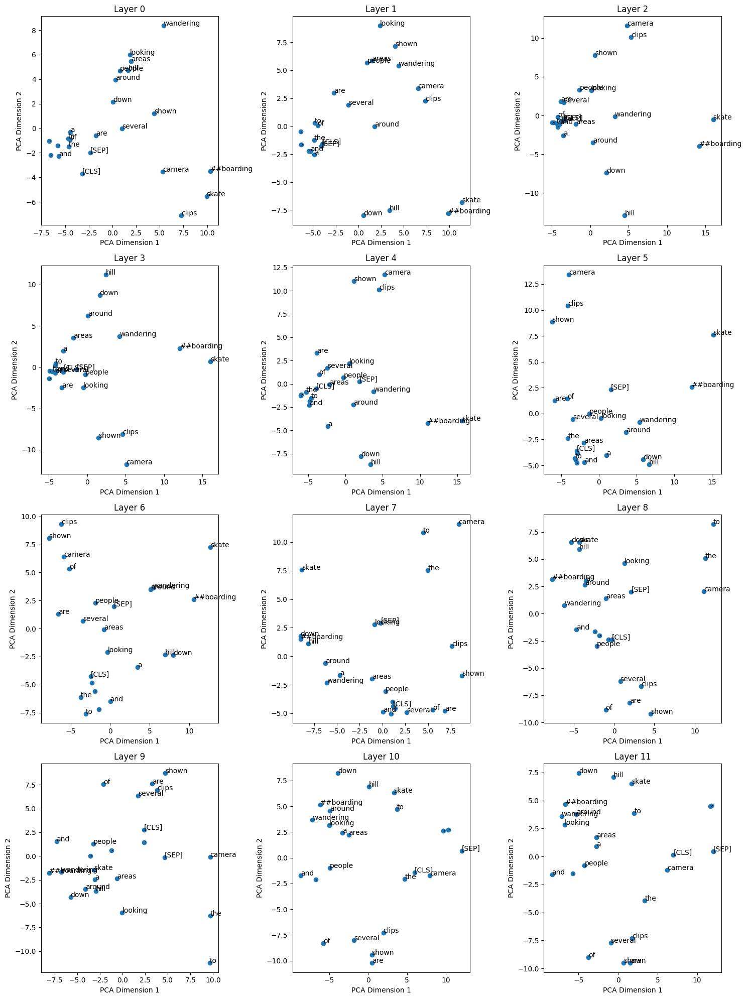

In [52]:
# Visualize contextual embeddings for the first caption
if selected_captions:
    print(selected_captions[0])
    visualize_contextual_embeddings(selected_captions[0], model, tokenizer)

## 2. Positional Embeddings Analysis

In this section, we'll analyze positional embeddings by inserting a sequence of text with the same word repeated 20 times. We'll visualize the embeddings and the distance across all tokens to understand how position affects the representation.

In [53]:
# Create a text with the same word repeated 20 times
repeated_word = "video"  # Choose a relevant word from the domain
repeated_text = " ".join([repeated_word] * 20)
print(f"Repeated text: {repeated_text}")

Repeated text: video video video video video video video video video video video video video video video video video video video video


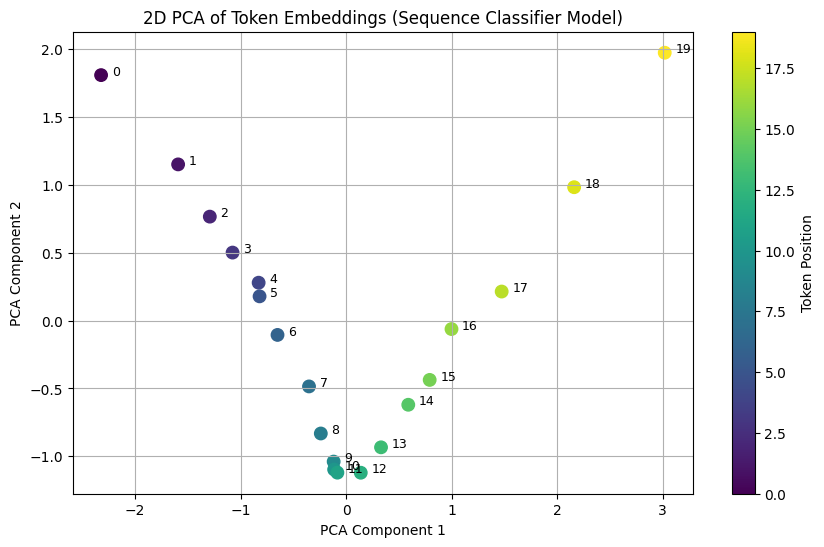

In [54]:
# 3. Tokenize and get embeddings
inputs = tokenizer(repeated_text, return_tensors="pt")
 #Run model and extract hidden states
with torch.no_grad():
    outputs = model(**inputs)
    hidden_states = outputs.hidden_states  # tuple: one tensor per layer

# Use the last layer's hidden states (token embeddings)
token_embeddings = hidden_states[-1].squeeze(0)  # shape: (seq_len, hidden_dim)
token_embeddings = token_embeddings[1:-1]
# Dimensionality reduction (PCA to 2D)
pca = PCA(n_components=2)
reduced = pca.fit_transform(token_embeddings.numpy())

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(reduced[:, 0], reduced[:, 1], c=range(len(reduced)), cmap='viridis', s=80)
for i, (x, y) in enumerate(reduced):
    plt.text(x + 0.1, y, str(i), fontsize=9)

plt.title("2D PCA of Token Embeddings (Sequence Classifier Model)")
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.colorbar(label="Token Position")
plt.grid(True)
plt.show()

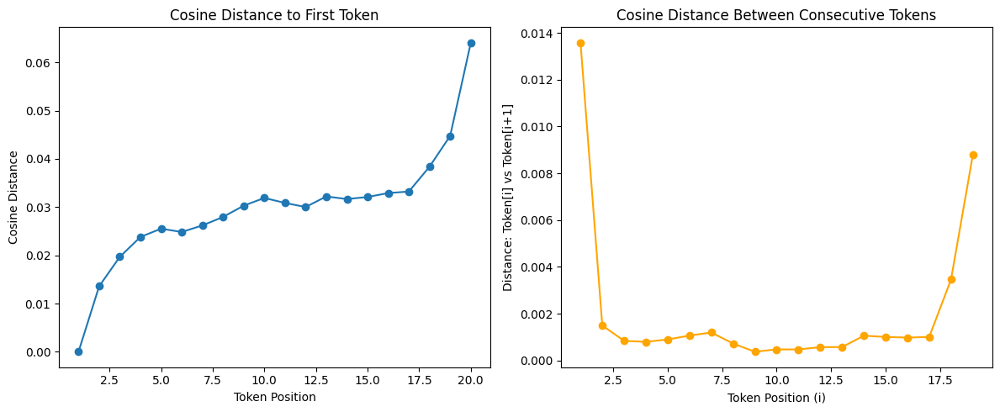

In [55]:
from scipy.spatial.distance import cosine
import matplotlib.pyplot as plt

# Convert to numpy
embeddings_np = token_embeddings.numpy()
num_tokens = embeddings_np.shape[0]

# Option 1: Distance to the first token
dist_to_first = [
    cosine(embeddings_np[0], embeddings_np[i]) for i in range(num_tokens)
]

# Option 2: Distance between consecutive tokens
consecutive_distances = [
    cosine(embeddings_np[i], embeddings_np[i + 1]) for i in range(num_tokens - 1)
]

# --- Plotting ---
plt.figure(figsize=(12, 5))

# Plot 1
plt.subplot(1, 2, 1)
plt.plot(range(1, num_tokens + 1), dist_to_first, marker='o')
plt.title("Cosine Distance to First Token")
plt.xlabel("Token Position")
plt.ylabel("Cosine Distance")

# Plot 2
plt.subplot(1, 2, 2)
plt.plot(range(1, num_tokens), consecutive_distances, marker='o', color='orange')
plt.title("Cosine Distance Between Consecutive Tokens")
plt.xlabel("Token Position (i)")
plt.ylabel("Distance: Token[i] vs Token[i+1]")

plt.tight_layout()
plt.show()


## 3. Self-Attention Mechanism Analysis

In this section, we'll examine the self-attention mechanism of a transformer cross-encoder and compare it with a dual encoder. We'll use a question-answering approach where we invent questions and use sentences from the videos as answers to analyze how the attention patterns differ between these two encoder types.

In [56]:
# Extract all captions from our filtered metadata
selected_captions = []
caption_video_mapping = {}

for video_id, metadata in filtered_metadata.items():
    if 'sentences' in metadata and metadata['sentences']:
        for sentence in metadata['sentences']:
            selected_captions.append(sentence)
            caption_video_mapping[sentence] = video_id

print(f"Total number of captions extracted: {len(selected_captions)}")
print("\nSample captions:")
for i, caption in enumerate(selected_captions[:5]):
    print(f"{i+1}. {caption} (from video: {caption_video_mapping[caption]})")

Total number of captions extracted: 41

Sample captions:
1. Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill. (from video: -ap649M020k)
2.  Several more people are shown skateboarding own various areas as well as swimming, rolling joints, and and surfing on the water. (from video: -ap649M020k)
3.  The men perform tricks, get naked, swim underwater, cut open a watermelon, as well as various other activities that lead back into skateboarding. (from video: -ap649M020k)
4. Boys play indoor soccer while kicking the ball and passing it to playmates, then the referee enter to the center and gives instructions. (from video: 74MEdLMrXAQ)
5.  Then, the referee puts the ball on the goal area and a boy kick the ball, but the goalkeeper stop the ball. (from video: 74MEdLMrXAQ)


In [57]:
# Create questions related to the video content
questions = [
    "What activities are shown in the video?",
    "What is happening in this scene?",
    "Can you describe the main action in this video?",
    "What techniques are demonstrated in this video?",
    "What is the person doing in this video?"
]

# Print the questions and selected answers
print("Questions:")
for i, question in enumerate(questions):
    print(f"{i+1}. {question}")

print("\nSelected answers from video sentences:")
for i, answer in enumerate(selected_captions[:5]):  # Show first 5 answers
    print(f"{i+1}. {answer}")

Questions:
1. What activities are shown in the video?
2. What is happening in this scene?
3. Can you describe the main action in this video?
4. What techniques are demonstrated in this video?
5. What is the person doing in this video?

Selected answers from video sentences:
1. Several clips are shown of people wandering around areas, looking to the camera, and skateboarding down a hill.
2.  Several more people are shown skateboarding own various areas as well as swimming, rolling joints, and and surfing on the water.
3.  The men perform tricks, get naked, swim underwater, cut open a watermelon, as well as various other activities that lead back into skateboarding.
4. Boys play indoor soccer while kicking the ball and passing it to playmates, then the referee enter to the center and gives instructions.
5.  Then, the referee puts the ball on the goal area and a boy kick the ball, but the goalkeeper stop the ball.


C:\Users\swimm\AppData\Local\Temp\ipykernel_2316\2010101729.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 0.95])


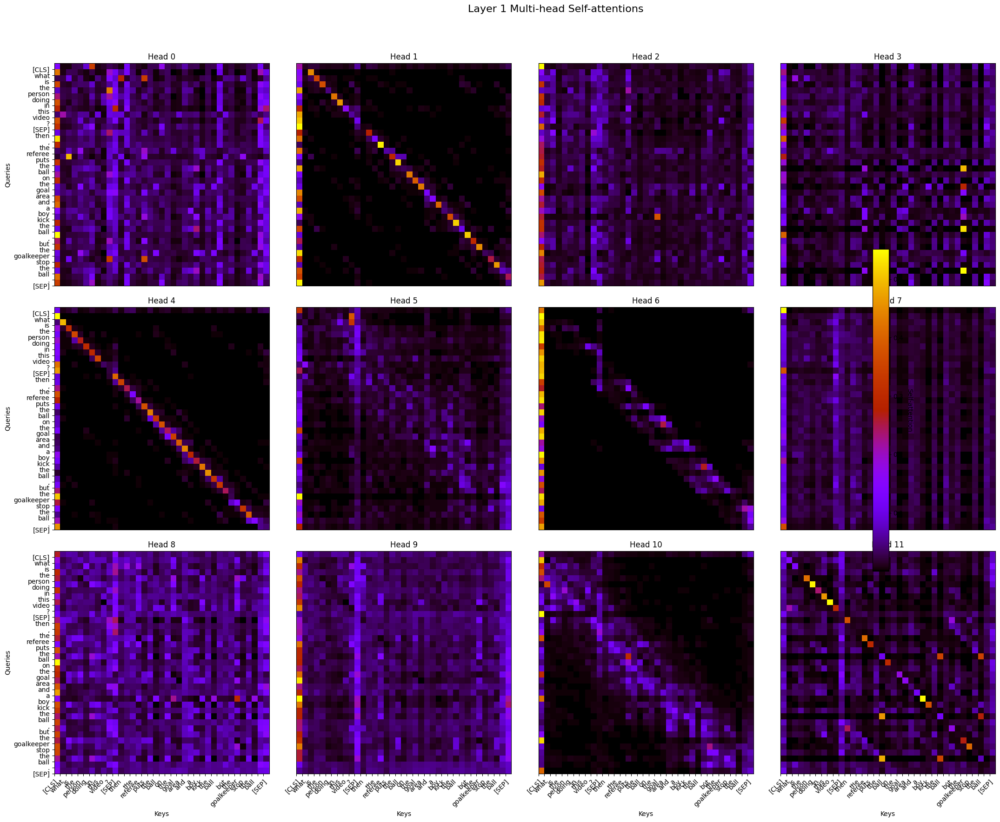

In [58]:
for i, (question, answer) in enumerate(zip(questions,selected_captions[:5])):
    text = f"{question} [SEP] {answer}"  # Combine question and answer if needed
    inputs = tokenizer.encode_plus(
        text,
        return_tensors='pt',
        add_special_tokens=True,
        max_length=512,
        truncation=True
    )

    input_ids = inputs['input_ids']
    input_id_list = input_ids[0].tolist()  # Batch index 0
    tokens = tokenizer.convert_ids_to_tokens(input_id_list)

    with torch.no_grad():
        outputs = model(**inputs)

    attention = outputs.attentions
    hidden_states = outputs.hidden_states
# Specify the layer to visualize
layer = 1  # Change this to the desired layer index (0-based)

# Define the grid dimensions
rows = 3
cols = 4
fig, ax_full = plt.subplots(rows, cols, figsize=(cols * 6, rows * 6))
plt.rcParams.update({'font.size': 10})

# Flatten the axes for easier iteration
axes = ax_full.flatten()

# Iterate over all heads in the specified layer
for head_idx in range(len(axes)):
    ax = axes[head_idx]
    
    # Extract self-attention weights for the current head
    sattention = attention[layer][0][head_idx].numpy()
    sattention = np.flip(sattention, 0)  # Flip for better visualization
    
    # Plot the attention weights
    im = ax.pcolormesh(sattention, cmap='gnuplot')
    
    # Set the title and axis labels
    ax.set_title(f"Head {head_idx}")
    ax.set_yticks(np.arange(len(tokens)))
    if head_idx % cols == 0:  # Only show y-tick labels for the first column
        ax.set_yticklabels(reversed(tokens))
        ax.set_ylabel("Queries")
    else:
        ax.set_yticks([])

    ax.set_xticks(np.arange(len(tokens)))
    if head_idx // cols == rows - 1:  # Only show x-tick labels for the last row
        ax.set_xticklabels(tokens)
        ax.set_xlabel("Keys")
        plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
    else:
        ax.set_xticks([])

# Add a colorbar to the figure
fig.suptitle(f"Layer {layer} Multi-head Self-attentions", fontsize=16)
cbar = fig.colorbar(im, ax=axes, location='right', shrink=0.5)
cbar.ax.set_ylabel("Self-attention", rotation=-90, va="bottom")

# Adjust layout and display the plot
plt.tight_layout(rect=[0, 0, 0.9, 0.95])
plt.show()

### INTERPRETABILITY

In [59]:

for i, (question, answer) in enumerate(zip(questions,selected_captions[:5])):
    text = f"{question} [SEP] {answer}"  # Combine question and answer if needed
    inputs = tokenizer.encode_plus(
        text,
        return_tensors='pt',
        add_special_tokens=True,
        max_length=512,
        truncation=True
    )

    input_ids = inputs['input_ids']
    input_id_list = input_ids[0].tolist()  # Batch index 0
    tokens = tokenizer.convert_ids_to_tokens(input_id_list)

    with torch.no_grad():
        outputs = model(**inputs)

    attention = outputs.attentions
    hidden_states = outputs.hidden_states

    call_html()
    head_view(attention, tokens)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Phase 2: Large Vision and Language Models 

## OpenSearch configuration

In [60]:
# Check if the index exists and, if so, delete it
if client.indices.exists(index=index_name):
    # Delete the index
    response = client.indices.delete(
        index = index_name
    )
    print('\nDeleting index:')
    print(response)

clip_index_body = {
    "settings": {
        "index": {
            "number_of_shards": 4,
            "number_of_replicas": 0,
            "refresh_interval": "1s",
            "knn": True
        }
    },
    "mappings": {
        "dynamic": "strict",
        "properties": {
            "video_id": {"type": "keyword"},
            "frame_id": {"type": "keyword"},
            "timestamp": {"type": "float"},
            "image_embedding": {
                "type": "knn_vector",
                "dimension": 512,
                "method": {
                    "name": "hnsw",
                    "space_type": "innerproduct",
                    "engine": "faiss",
                    "parameters": {"ef_construction": 128, "m": 32}
                }
            },
            "text": {"type": "text"},
            "text_embedding": {
                "type": "knn_vector",
                "dimension": 512,
                "method": {
                    "name": "hnsw",
                    "space_type": "innerproduct",
                    "engine": "faiss",
                    "parameters": {"ef_construction": 128, "m": 32}
                }
            }
        }
    }
}

# Creating the index
if client.indices.exists(index=index_name):
    print("The index already exists. No action needed.")
else:        
    response = client.indices.create(index_name, body=clip_index_body)
    print('\nIndex creation:')
    print(response)


Deleting index:
{'acknowledged': True}

Index creation:
{'acknowledged': True, 'shards_acknowledged': True, 'index': 'user12'}


## Loading CLIP model

In [61]:
from transformers import CLIPProcessor, CLIPModel
from transformers import CLIPTokenizer, CLIPTextModel
from transformers import CLIPVisionModel, CLIPVisionConfig
from PIL import Image
import requests
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import torch

clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model.eval()
print("CLIP model loaded.")

CLIP model loaded.


## Extracting frames

In [62]:
def extract_frames(video_path, frame_rate=0.5):
    container = av.open(video_path)
    stream = container.streams.video[0]
    stream.thread_type = 'AUTO'
    frames = []
    for frame in container.decode(stream):
        if frame.pts * stream.time_base >= len(frames) * 2:
            img = frame.to_image()
            frames.append((img, frame.pts * stream.time_base))
    return frames

In [63]:
@torch.no_grad()
def encode_image(image):
    inputs = clip_processor(images=image, return_tensors="pt")
    outputs = clip_model.get_image_features(**inputs)
    return torch.nn.functional.normalize(outputs, p=2, dim=1).squeeze().cpu().numpy()

@torch.no_grad()
def encode_text(text):
    inputs = clip_processor(text=[text], return_tensors="pt", padding=True, truncation=True)
    outputs = clip_model.get_text_features(**inputs)
    return torch.nn.functional.normalize(outputs, p=2, dim=1).squeeze().cpu().numpy()

In [64]:
import os
from tqdm import tqdm

for video_file in tqdm(os.listdir(download_folder)):
    if not video_file.endswith(".mp4"):
        continue

    video_path = os.path.join(download_folder, video_file)
    video_id = os.path.splitext(video_file)[0]
    
    try:
        frames = extract_frames(video_path)
    except Exception as e:
        print(f"Error reading {video_file}: {e}")
        continue

    actions = []
    for i, (image, timestamp) in enumerate(frames):
        try:
            image_embedding = encode_image(image)
            timestamp_float = float(timestamp)
            default_text = f"Frame from video {video_id} at {timestamp_float:.2f} seconds"
            text_embedding = encode_text(default_text)

            doc = {
                "video_id": video_id,
                "frame_id": f"{video_id}_frame_{i}",
                "timestamp": timestamp_float,
                "image_embedding": image_embedding,
                "text": default_text,
                "text_embedding": text_embedding
            }

            actions.append({
                "_index": index_name,
                "_id": doc["frame_id"],
                "_source": doc
            })
        except Exception as e:
            print(f"Encoding failed for {video_file}, frame {i}: {e}")

    if actions:
        helpers.bulk(client, actions)
        client.indices.refresh(index=index_name)

print("Indexing complete.")

  0%|          | 0/10 [00:00<?, ?it/s]

100%|██████████| 10/10 [02:40<00:00, 16.04s/it]

Indexing complete.


## Text search

In [65]:
def search_by_text(query_text, k=5):
    query_vector = encode_text(query_text).tolist()
    
    query_body = {
        "size": k,
        "query": {
            "knn": {
                "image_embedding": {
                    "vector": query_vector,
                    "k": k
                }
            }
        }
    }
    
    response = client.search(index=index_name, body=query_body)

    results = []
    for hit in response["hits"]["hits"]:
        source = hit["_source"]
        results.append({
            "video_id": source["video_id"],
            "timestamp": source["timestamp"],
            "frame_id": source["frame_id"],
            "text": source["text"]
        })

    return results


example_query = "a man riding a bicycle on the street"
results = search_by_text(example_query)
print("\nSearch results:")
for res in results:
    print(res)
    # print(res['_source']['video_id'], res['_source']['timestamp'], res['_score'])


Search results:
{'video_id': '-ap649M020k - HK Longboarding - Looking Back 2011', 'timestamp': 166.03253333333333, 'frame_id': '-ap649M020k - HK Longboarding - Looking Back 2011_frame_83', 'text': 'Frame from video -ap649M020k - HK Longboarding - Looking Back 2011 at 166.03 seconds'}
{'video_id': '-ap649M020k - HK Longboarding - Looking Back 2011', 'timestamp': 190.02316666666667, 'frame_id': '-ap649M020k - HK Longboarding - Looking Back 2011_frame_95', 'text': 'Frame from video -ap649M020k - HK Longboarding - Looking Back 2011 at 190.02 seconds'}
{'video_id': '-ap649M020k - HK Longboarding - Looking Back 2011', 'timestamp': 172.00516666666667, 'frame_id': '-ap649M020k - HK Longboarding - Looking Back 2011_frame_86', 'text': 'Frame from video -ap649M020k - HK Longboarding - Looking Back 2011 at 172.01 seconds'}
{'video_id': '-ap649M020k - HK Longboarding - Looking Back 2011', 'timestamp': 58.024633333333334, 'frame_id': '-ap649M020k - HK Longboarding - Looking Back 2011_frame_29', 'te

In [66]:
example_query = "men working out in a gym"
results = search_by_text(example_query)
print("\nSearch results:")
for res in results:
    print(res)


Search results:
{'video_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength', 'timestamp': 126.0259, 'frame_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength_frame_63', 'text': 'Frame from video jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength at 126.03 seconds'}
{'video_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength', 'timestamp': 0.0, 'frame_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength_frame_0', 'text': 'Frame from video jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength at 0.00 seconds'}
{'video_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength', 'timestamp': 16.016, 'frame_id': 'jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength_frame_8', 'text': 'Frame from video jBvGvVw3R-Q - The King of American Weightlifting Visits Cal Strength at 16.02 seconds'}
{'video_id': 'jBvGvVw3R-Q - The King of America

## Image search

In [67]:
image_path = "screenshot_futsal.png"
image = Image.open(image_path).convert("RGB")
image_embedding = encode_image(image)
embedding_vector = image_embedding.squeeze().tolist()

knn_query = {
    "size": 5,
    "query": {
        "knn": {
            "image_embedding": {
                "vector": embedding_vector,
                "k": 5
            }
        }
    }
}

response = client.search(index=index_name, body=knn_query)

print("Search results:")
for hit in response["hits"]["hits"]:
    source = hit["_source"]
    print(source["video_id"], source["timestamp"], hit["_score"])


Search results:
74MEdLMrXAQ - Basic futsal rules 50.01663333333333 1.9403548
74MEdLMrXAQ - Basic futsal rules 168.00116666666668 1.9393361
74MEdLMrXAQ - Basic futsal rules 66.03263333333334 1.9312756
74MEdLMrXAQ - Basic futsal rules 54.020633333333336 1.9259152
74MEdLMrXAQ - Basic futsal rules 102.0019 1.9209559


## Llava Model

In [68]:
!pip install -q ollama
from ollama import Client

llava_client = Client(
  host='https://twiz.novasearch.org/ollama',
  headers={'x-some-header': 'some-value'}
)

model_multimodal = 'llava-phi3:latest'

response = llava_client.generate(model=model_multimodal, prompt='What are top 3 places to visit in Madeira?')
print(response.response)

1. The South of the island: Includes beautiful beaches, such as Porto da Cruz and Praia de Monte Brander; picturesque villages like Funchal, Ponta do Sol and Caniço. Visit the vineyards for wine tasting in Estufas de Caldeira and Funchal Wine Factory.
2. The North of the island: This is where Madeira's rich history lies. Visit Porto Santo Island, Horta harbor, a town with preserved 18th-century buildings, Fortress do Pico and Monte Palace. Inland, visit the Botanical Garden in Funchal and the Natural History Museum of Maciço Alto.
3. The West of the island: Visit Ribeira Brava for the Fish Market, Tamar dos Carneiros for historic ships and a walk along the waterfront. Also visit Ponta de São Lourenzo, Pina da Bolsa and Porto Moniz.


In [69]:
import base64
from io import BytesIO
from PIL import Image

def encode_image_base64(image_path):
    with Image.open(image_path) as img:
        buffered = BytesIO()
        img.save(buffered, format="PNG")
        img_str = base64.b64encode(buffered.getvalue()).decode("utf-8")
    return img_str

def ask_llava(image_path, question):
    image_base64 = encode_image_base64(image_path)

    response = llava_client.generate(
        model=model_multimodal,
        prompt=question,
        images=[image_base64]
    )

    return response['response']

image_path = "screenshot_futsal.png"
question = "What is happening in this image?"

answer = ask_llava(image_path, question)
print("Answer:", answer)

Answer: In the image, a group of young children are actively participating in a basketball game on an indoor court. They are playing against each other with various team colors, creating a lively and competitive atmosphere. Some of the kids are dribbling the ball while others are running around to defend their positions or create scoring opportunities. The wooden bleachers at one end of the court accommodate spectators who are watching the game unfold, adding an element of excitement for both the players and audience. A scoreboard on the wall displays the current score and team points, allowing everyone to track the progress of the match as it continues. Overall, this image captures a fun and energetic moment from a youth basketball game.


## Retrieval Augmented VQA

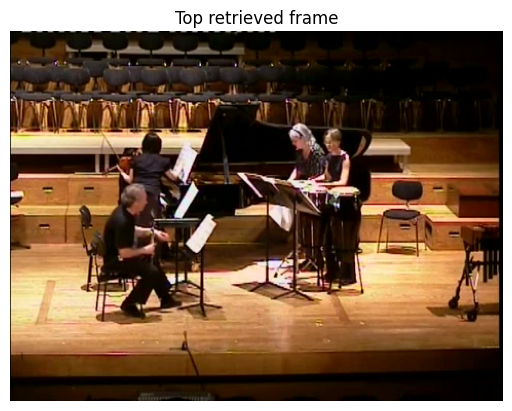

Q: What is the main instrument in this image?
A: The primary instrument featured in the image is a piano. There are also other instruments, such as xylophones and drum sets, present on stage.


In [70]:
import av
import matplotlib.pyplot as plt
import io

def extract_frame_at_timestamp(video_path, timestamp):
    container = av.open(video_path)
    stream = container.streams.video[0]
    stream.codec_context.skip_frame = 'NONKEY'
    container.seek(int(timestamp * av.time_base))
    for frame in container.decode(stream):
        if frame.pts * stream.time_base >= timestamp:
            image = frame.to_image()
            return image
    return None

def ask_llava_about_frame(query_text, question, download_folder):
    results = search_by_text(query_text)
    if not results:
        print("No relevant frames found.")
        return

    result = results[0]
    video_path = os.path.join(download_folder, result['video_id'] + ".mp4")
    image = extract_frame_at_timestamp(video_path, result["timestamp"])

    if image is None:
        print("Could not extract image.")
        return
    else:
        plt.imshow(image)
        plt.axis('off')
        plt.title("Top retrieved frame")
        plt.show()

    image_bytes = io.BytesIO()
    image.save(image_bytes, format='PNG')
    image_bytes = image_bytes.getvalue()

    response = llava_client.generate(
        model=model_multimodal,
        prompt=question,
        images=[image_bytes]
    )

    print("Q:", question)
    print("A:", response['response'])

ask_llava_about_frame(
    query_text="Philarmonic Orchestra playing",
    question="What is the main instrument in this image?",
    download_folder="./downloads"
)

## Language-Vision temporal similarity

C:\Users\swimm\AppData\Local\Temp\ipykernel_2316\946624770.py:43: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = cm.get_cmap('tab10', num_captions)


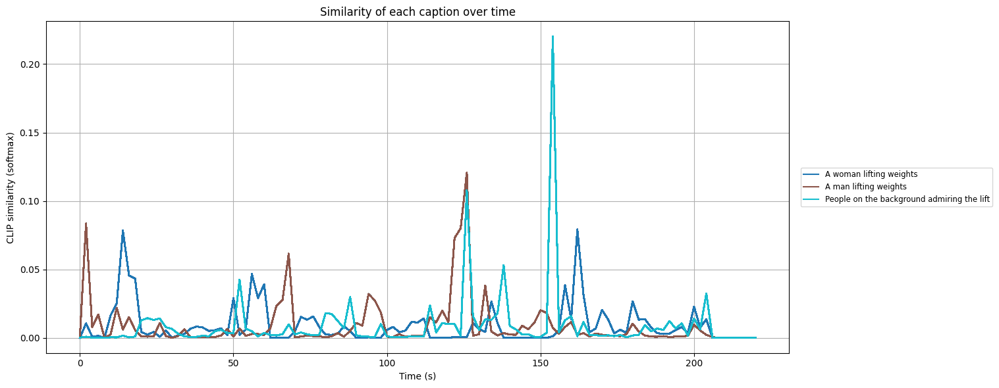

In [71]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

def extract_frames_timestamps(video_path, interval=2.0):
    container = av.open(video_path)
    stream = container.streams.video[0]
    duration = float(stream.duration * stream.time_base)

    frames = []
    timestamps = []

    for i in range(int(duration // interval) + 1):
        ts = i * interval
        container.seek(int(ts / stream.time_base), any_frame=False, backward=True, stream=stream)

        for frame in container.decode(video=0):
            frame_ts = frame.pts * stream.time_base
            if frame_ts >= ts:
                frames.append(frame.to_image())
                timestamps.append(ts)
                break
    return frames, timestamps

def compute_clip_scores(frames, captions):
    all_scores = []
    for caption in captions:
        inputs = clip_processor(text=[caption] * len(frames), images=frames, return_tensors="pt", padding=True)
        with torch.no_grad():
            outputs = clip_model(**inputs)
            probs = outputs.logits_per_image.softmax(dim=0).squeeze().numpy()
        all_scores.append(probs)
    return np.array(all_scores)

def plot_similarity(scores, timestamps, captions):
    """
    scores: List[List[float]] — shape: (num_captions, num_frames)
    timestamps: List[float] — len: num_frames
    captions: List[str] — len: num_captions
    """
    plt.figure(figsize=(18, 6))

    num_captions = len(captions)
    color_map = cm.get_cmap('tab10', num_captions)

    for i in range(num_captions):
        plt.plot(timestamps, scores[i], label=captions[i], color=color_map(i))

    plt.xlabel("Time (s)")
    plt.ylabel("CLIP similarity (softmax)")
    plt.title("Similarity of each caption over time")
    plt.grid(True)

    handles, labels = plt.gca().get_legend_handles_labels()
    unique = dict(zip(labels, handles))
    plt.legend(unique.values(), unique.keys(), loc='center left', bbox_to_anchor=(1.01, 0.5), fontsize='small')

    plt.tight_layout(rect=[0, 0, 0.85, 1])
    plt.show()

video_path = "./downloads/8JKK6JayDeA - Olympic Weightlifting 3-11-15 - Snatch, OHS, Clean, Jerk.mp4"
captions = [
    "A woman lifting weights",
    "A man lifting weights",
    "People on the background admiring the lift",
]
frames, timestamps = extract_frames_timestamps(video_path, interval=2.0)
scores = compute_clip_scores(frames, captions)
plot_similarity(scores, timestamps, captions)

In [74]:
!pip install einops ftfy captum regex

import CLIP.clip as clip
import torch
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from captum.attr import visualization
import torch

In [75]:
#@title Control context expansion (number of attention layers to consider)
#@title Number of layers for image Transformer
start_layer =  -1#@param {type:"number"}

#@title Number of layers for text Transformer
start_layer_text =  -1#@param {type:"number"}

def interpret(image, texts, model, device, start_layer=start_layer, start_layer_text=start_layer_text):
    batch_size = texts.shape[0]
    images = image.repeat(batch_size, 1, 1, 1)
    logits_per_image, logits_per_text = model(images, texts)
    #
    # print(logits_per_image)
    probs = logits_per_image.softmax(dim=-1).detach().cpu().numpy()
    index = [i for i in range(batch_size)]
    one_hot = np.zeros((logits_per_image.shape[0], logits_per_image.shape[1]), dtype=np.float32)
    one_hot[torch.arange(logits_per_image.shape[0]), index] = 1
    one_hot = torch.from_numpy(one_hot).requires_grad_(True)
    one_hot = torch.sum(one_hot.cuda() * logits_per_image)
    model.zero_grad()

    image_attn_blocks = list(dict(model.visual.transformer.resblocks.named_children()).values())

    if start_layer == -1:
      # calculate index of last layer
      start_layer = len(image_attn_blocks) - 1

    num_tokens = image_attn_blocks[0].attn_probs.shape[-1]
    R = torch.eye(num_tokens, num_tokens, dtype=image_attn_blocks[0].attn_probs.dtype).to(device)
    R = R.unsqueeze(0).expand(batch_size, num_tokens, num_tokens)
    for i, blk in enumerate(image_attn_blocks):
        if i < start_layer:
            continue
        grad = torch.autograd.grad(one_hot, [blk.attn_probs], retain_graph=True)[0].detach()
        cam = blk.attn_probs.detach()
        cam = cam.reshape(-1, cam.shape[-1], cam.shape[-1])
        grad = grad.reshape(-1, grad.shape[-1], grad.shape[-1])
        cam = grad * cam
        cam = cam.reshape(batch_size, -1, cam.shape[-1], cam.shape[-1])
        cam = cam.clamp(min=0).mean(dim=1)
        R = R + torch.bmm(cam, R)
    image_relevance = R[:, 0, 1:]


    text_attn_blocks = list(dict(model.transformer.resblocks.named_children()).values())

    if start_layer_text == -1:
      # calculate index of last layer
      start_layer_text = len(text_attn_blocks) - 1

    num_tokens = text_attn_blocks[0].attn_probs.shape[-1]
    R_text = torch.eye(num_tokens, num_tokens, dtype=text_attn_blocks[0].attn_probs.dtype).to(device)
    R_text = R_text.unsqueeze(0).expand(batch_size, num_tokens, num_tokens)
    for i, blk in enumerate(text_attn_blocks):
        if i < start_layer_text:
            continue
        grad = torch.autograd.grad(one_hot, [blk.attn_probs], retain_graph=True)[0].detach()
        cam = blk.attn_probs.detach()
        cam = cam.reshape(-1, cam.shape[-1], cam.shape[-1])
        grad = grad.reshape(-1, grad.shape[-1], grad.shape[-1])
        cam = grad * cam
        cam = cam.reshape(batch_size, -1, cam.shape[-1], cam.shape[-1])
        cam = cam.clamp(min=0).mean(dim=1)
        R_text = R_text + torch.bmm(cam, R_text)
    text_relevance = R_text

    return text_relevance, image_relevance, logits_per_text, logits_per_image

In [76]:
import matplotlib.pyplot as plt

def show_image_relevance(image_relevance, image, orig_image):
    # create heatmap from mask on image
    def show_cam_on_image(img, mask):
        cmap = plt.get_cmap('jet')
        rgba_img = cmap(mask)
        heatmap = np.delete(rgba_img, 3, 2)
        cam = np.float32(heatmap) / np.max(heatmap)
        cam = (cam + img)/2
        return cam

    fig, axs = plt.subplots(1, 2)
    axs[0].imshow(orig_image);
    axs[0].axis('off');

    dim = int(image_relevance.numel() ** 0.5)
    image_relevance = image_relevance.reshape(1, 1, dim, dim)
    image_relevance = torch.nn.functional.interpolate(image_relevance, size=224, mode='bilinear')
    image_relevance = image_relevance.reshape(224, 224).cuda().data.cpu().numpy()
    image_relevance = (image_relevance - image_relevance.min()) / (image_relevance.max() - image_relevance.min())
    image = image[0].permute(1, 2, 0).data.cpu().numpy()
    image = (image - image.min()) / (image.max() - image.min())
    vis = show_cam_on_image(image, image_relevance)
    vis = np.uint8(255 * vis)
    axs[1].imshow(vis);
    axs[1].axis('off');

from clip.simple_tokenizer import SimpleTokenizer as _Tokenizer
_tokenizer = _Tokenizer()

def show_heatmap_on_text(text, text_encoding, R_text):
    CLS_idx = text_encoding.argmax(dim=-1)
    R_text = R_text[CLS_idx, 1:CLS_idx]
    text_scores = R_text / R_text.sum()
    text_scores = text_scores.flatten()
    # print(text_scores)
    text_tokens=_tokenizer.encode(text)
    text_tokens_decoded=[_tokenizer.decode([a]) for a in text_tokens]
    vis_data_records = [visualization.VisualizationDataRecord(text_scores,0,0,0,0,0,text_tokens_decoded,1)]
    visualization.visualize_text(vis_data_records)

In [77]:
clip._MODELS = {
    "ViT-B/32": "https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt",
    "ViT-B/16": "https://openaipublic.azureedge.net/clip/models/5806e77cd80f8b59890b7e101eabd078d9fb84e6937f9e85e4ecb61988df416f/ViT-B-16.pt",
    "ViT-L/14": "https://openaipublic.azureedge.net/clip/models/b8cca3fd41ae0c99ba7e8951adf17d267cdb84cd88be6f7c2e0eca1737a03836/ViT-L-14.pt",
}

class color:
    PURPLE = '\033[95m'
    CYAN = '\033[96m'
    DARKCYAN = '\033[36m'
    BLUE = '\033[94m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    RED = '\033[91m'
    BOLD = '\033[1m'
    UNDERLINE = '\033[4m'
    END = '\033[0m'

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device, jit=False)

C:\Users\swimm\AppData\Local\Temp\ipykernel_2316\450787246.py:20: RuntimeWarning: invalid value encountered in divide
  image_tensor = (image_tensor - image_tensor.min()) / (image_tensor.max() - image_tensor.min())


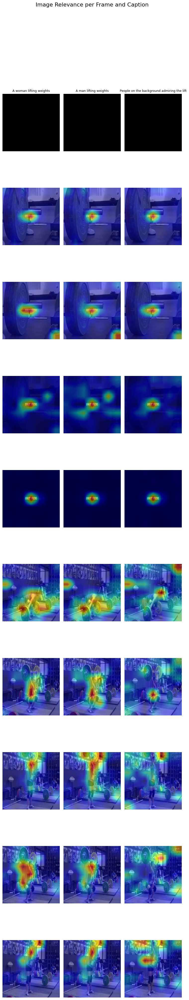

True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,0 (0.00),0,0.00,a woman lifting weights


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,0 (0.00),0,0.00,a man lifting weights


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,0 (0.00),0,0.00,people on the background admiring the lift


In [83]:
def visualize_interpretation_grid(frames, captions, model, preprocess, device, max_frames=10):
    frames = frames[:max_frames]
    num_frames = len(frames)

    fig, axs = plt.subplots(num_frames, len(captions), figsize=(2.5 * len(captions), 4.2 * num_frames))

    for j, frame_pil in enumerate(frames):
        img_tensor = preprocess(frame_pil).unsqueeze(0).to(device)

        for i, caption in enumerate(captions):
            text_token = clip.tokenize([caption]).to(device)

            R_text, R_image, _, _ = interpret(model=model, image=img_tensor, texts=text_token, device=device)

            ax = axs[j, i] if len(frames) > 1 else axs[i]

            relevance_map = R_image[0]
            image_resized = frame_pil.resize((224, 224))
            image_tensor = to_tensor(image_resized).permute(1, 2, 0).numpy()
            image_tensor = (image_tensor - image_tensor.min()) / (image_tensor.max() - image_tensor.min())

            relevance_map = relevance_map.reshape(1, 1, 7, 7)
            relevance_map = torch.nn.functional.interpolate(relevance_map, size=(224, 224), mode='bilinear')[0, 0].cpu().numpy()
            relevance_map = (relevance_map - relevance_map.min()) / (relevance_map.max() - relevance_map.min())

            cmap = plt.get_cmap("jet")(relevance_map)[..., :3]
            overlay = (image_tensor + cmap) / 2

            ax.imshow(overlay)
            ax.axis("off")
            if j == 0:
                ax.set_title(caption, fontsize=9)
            if i == 0:
                ax.set_ylabel(f"{j * 2:.1f}s", fontsize=9)

    plt.suptitle("Image Relevance per Frame and Caption", fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()

    for i, caption in enumerate(captions):
        text_token = clip.tokenize([caption]).to(device)
        img_tensor = preprocess(frames[0]).unsqueeze(0).to(device)
        R_text, _, _, _ = interpret(model=model, image=img_tensor, texts=text_token, device=device)
        show_heatmap_on_text(caption, text_token[0], R_text[0])
        plt.show()


visualize_interpretation_grid(frames, captions, model, preprocess, device)